In [1]:
print("hello")

hello


In [53]:
import pytesseract
from PIL import Image
import pandas as pd

# Set Tesseract path (only needed if not in system PATH)
pytesseract.pytesseract.tesseract_cmd = r"C:\Program Files\Tesseract-OCR\tesseract.exe"  

# Load the image
image_path = r".\dataset\Symptom2Disease_dataset_test\patient_0_report.png"  
img = Image.open(image_path)
img.show()

# Extract text
extracted_text = pytesseract.image_to_string(img)
# Find the symptoms section

print(extracted_text)


Patient Report Berlin Hospital

Patient Name: Classified
Date: 2022-06-05

Symptoms:

I've been experiencing chills, feel really exhausted, and my
cough just won't go away. When | cough, my chest aches and
my heart is pounding. It's a disgusting brownish hue, the
mucous I'm coming up.



In [55]:
import os
import pytesseract
from PIL import Image
import pandas as pd

# Set Tesseract path (only needed if not in system PATH)
pytesseract.pytesseract.tesseract_cmd = r"C:\Program Files\Tesseract-OCR\tesseract.exe"

# Define the base directories (ensure to add all dataset folders you need)
base_dirs = [
    r".\dataset\gretalai_dataset_test",
    r".\dataset\gretalai_dataset_train",
    r".\dataset\Symptom2Disease_dataset_test",
    r".\dataset\Symptom2Disease_dataset_train",
    r".\dataset\venetis_dataset_test",
    r".\dataset\venetis_dataset_train"
    # Add any other directories here
]

# Iterate through each dataset folder
for base_dir in base_dirs:
    # Create an empty list to store extracted text data
    extracted_data = []

    # Iterate over all files in the current folder and its subfolders (recursively)
    for root, dirs, files in os.walk(base_dir):
        for file_name in files:
            # Check if the file is a PNG file
            if file_name.lower().endswith('.png'):
                file_path = os.path.join(root, file_name)

                # Open the image
                img = Image.open(file_path)

                # Extract text using pytesseract
                extracted_text = pytesseract.image_to_string(img)

                # Find the symptoms section
                #if "Symptoms:" in extracted_text:
                #    symptoms = extracted_text.split("Symptoms:")[-1].strip()
                #else:
                #    symptoms = "Not Found"
                #if "Hospital Name:" in symptoms:
                #    symptom = symptoms.split("Hospital Name:")[0].strip()
                #extracted_text=symptom

                # Append the extracted text to the list
                extracted_data.append({"File Name": file_name, "Extracted Text": extracted_text})

    # Convert the extracted text data to a DataFrame
    df = pd.DataFrame(extracted_data)

    # Save the DataFrame to a CSV file, named after the dataset folder
    output_csv_path = os.path.join(r".\csv1", f"{os.path.basename(base_dir)}_extracted_text.csv")
    df.to_csv(output_csv_path, index=False)

    print(f"✅ Text extracted and saved to {output_csv_path}")


✅ Text extracted and saved to .\csv1\gretalai_dataset_test_extracted_text.csv
✅ Text extracted and saved to .\csv1\gretalai_dataset_train_extracted_text.csv
✅ Text extracted and saved to .\csv1\Symptom2Disease_dataset_test_extracted_text.csv
✅ Text extracted and saved to .\csv1\Symptom2Disease_dataset_train_extracted_text.csv
✅ Text extracted and saved to .\csv1\venetis_dataset_test_extracted_text.csv
✅ Text extracted and saved to .\csv1\venetis_dataset_train_extracted_text.csv


In [22]:
import pandas as pd
import os

# Load both CSV files into pandas DataFrames
df1 = pd.read_csv(r'./csv/gretalai_dataset_test_extracted_text.csv')  # Adjust the path as needed
df2 = pd.read_csv(r'./dataset/gretalai_dataset_test.csv')  # Adjust the path as needed

# Normalize the 'file_name' column by extracting the base file name from any path in df2
df2['file_name'] = df2['file_name'].apply(lambda x: os.path.basename(x))

# Ensure the column names are the same in both DataFrames
df1.rename(columns={'File Name': 'file_name'}, inplace=True)

# Merge the DataFrames based on the 'file_name' column
merged_df = pd.merge(df1, df2, on='file_name', how='inner')

# Save the merged DataFrame to a new CSV file named 'file_extracted_disease.csv'
merged_df.to_csv('file_extracted_disease.csv', index=False)

# Optionally, display the first few rows of the merged DataFrame
print(merged_df.head())



                file_name                                     Extracted Text  \
0    patient_0_report.png  | have a burning sensation in my stomach that ...   
1  patient_100_report.png  | have been having headaches for a while now. ...   
2  patient_101_report.png  I've been having a headache all day, and it's ...   
3  patient_102_report.png  | have been having to pee a lot more often tha...   
4  patient_103_report.png  | have heartburn and indigestion. | regularly ...   

                           disease  
0             Peptic Ulcer Disease  
1                         Migraine  
2                     Hypertension  
3          Urinary Tract Infection  
4  Gastroesophageal Reflux Disease  


In [46]:
import os
import pytesseract
from PIL import Image
import pandas as pd

# Set Tesseract path (only needed if not in system PATH)
pytesseract.pytesseract.tesseract_cmd = r"C:\Program Files\Tesseract-OCR\tesseract.exe"

# Define the base directories (ensure to add all dataset folders you need)
base_dirs = [
    r".\dataset\gretalai_dataset_test",
    r".\dataset\gretalai_dataset_train",
    r".\dataset\Symptom2Disease_dataset_test",
    r".\dataset\Symptom2Disease_dataset_train",
    r".\dataset\venetis_dataset_test",
    r".\dataset\venetis_dataset_train"
    # Add any other directories here
]

# Iterate through each dataset folder
#for base_dir in base_dirs:
    # Create an empty list to store extracted text data
base_dir=r".\dataset\Symptom2Disease_dataset_test"
extracted_data = []

# Iterate over all files in the current folder and its subfolders (recursively)
for root, dirs, files in os.walk(base_dir):
    for file_name in files:
        # Check if the file is a PNG file
        if file_name.lower().endswith('.png'):
            file_path = os.path.join(root, file_name)

            # Open the image
            img = Image.open(file_path)

            # Extract text using pytesseract
            extracted_text = pytesseract.image_to_string(img)

            # Find the symptoms section
            if "Symptoms:" in extracted_text:
                symptoms = extracted_text.split("Symptoms:")[-1].strip()
            else:
                symptoms = "Not Found"
            if "Hospital Name:" in symptoms:
                symptom = symptoms.split("Hospital Name:")[0].strip()
            extracted_text=symptom

            # Append the extracted text to the list
            extracted_data.append({"File Name": file_name, "Extracted Text": extracted_text})

# Convert the extracted text data to a DataFrame
df = pd.DataFrame(extracted_data)

# Save the DataFrame to a CSV file, named after the dataset folder
output_csv_path = os.path.join(r".\csv", f"{os.path.basename(base_dir)}_extracted_text.csv")
df.to_csv(output_csv_path, index=False)

print(f"✅ Text extracted and saved to {output_csv_path}")


✅ Text extracted and saved to .\csv\Symptom2Disease_dataset_test_extracted_text.csv


In [63]:
import pandas as pd
import os

# Load both CSV files into pandas DataFrames
df1 = pd.read_csv(r'./csv1/gretalai_dataset_test_extracted_text.csv')  # Adjust the path as needed
df2 = pd.read_csv(r'./dataset/gretalai_dataset_test.csv')  # Adjust the path as needed

# Normalize the 'file_name' column by extracting the base file name from any path in df2
df2['file_name'] = df2['file_name'].apply(lambda x: os.path.basename(x))

# Ensure the column names are the same in both DataFrames
df1.rename(columns={'File Name': 'file_name'}, inplace=True)

# Merge the DataFrames based on the 'file_name' column
merged_df = pd.merge(df1, df2, on='file_name', how='inner')

# Drop the 'file_name' column from the merged DataFrame
merged_df = merged_df.drop(columns=['file_name'])

# Save the resulting DataFrame to a new CSV file in the existing repository
# You can adjust the directory and file name as needed
merged_df.to_csv(r'./data 4/gretalai_dataset_test.csv', index=False)

# Optionally, display the first few rows of the final DataFrame
print(merged_df.head())


                                      Extracted Text  \
0  @y Patient Report\n\nPatient Name: Classified\...   
1  @y Patient Report\n\nPatient Name: Classified\...   
2  @y Patient Report\n\nPatient Name: Classified\...   
3  @y Patient Report\n\nPatient Name: Classified\...   
4  @y Patient Report\n\nPatient Name: Classified\...   

                           disease  
0             Peptic Ulcer Disease  
1                         Migraine  
2                     Hypertension  
3          Urinary Tract Infection  
4  Gastroesophageal Reflux Disease  


In [58]:
import pandas as pd
import os

# Load both CSV files into pandas DataFrames
df1 = pd.read_csv(r'./csv1\gretalai_dataset_train_extracted_text.csv')  # Adjust the path as needed
df2 = pd.read_csv(r'./dataset\gretalai_dataset_train.csv')  # Adjust the path as needed

# Normalize the 'file_name' column by extracting the base file name from any path in df2
df2['file_name'] = df2['file_name'].apply(lambda x: os.path.basename(x))

# Ensure the column names are the same in both DataFrames
df1.rename(columns={'File Name': 'file_name'}, inplace=True)

# Merge the DataFrames based on the 'file_name' column
merged_df = pd.merge(df1, df2, on='file_name', how='inner')

# Drop the 'file_name' column from the merged DataFrame
merged_df = merged_df.drop(columns=['file_name'])

# Save the resulting DataFrame to a new CSV file in the existing repository
# You can adjust the directory and file name as needed
merged_df.to_csv(r'./data 4/gretalai_dataset_train.csv', index=False)

# Optionally, display the first few rows of the final DataFrame
print(merged_df.head())


                                      Extracted Text               disease
0  @y Patient Report\n\nPatient Name: Classified\...  Cervical Spondylosis
1  @y Patient Report\n\nPatient Name: Classified\...      Bronchial Asthma
2  @y Patient Report\n\nPatient Name: Classified\...              Migraine
3  @y Patient Report\n\nPatient Name: Classified\...  Peptic Ulcer Disease
4  @y Patient Report\n\nPatient Name: Classified\...              Diabetes


In [64]:
import pandas as pd
import os

# Load both CSV files into pandas DataFrames
df1 = pd.read_csv(r'./csv1\Symptom2Disease_dataset_test_extracted_text.csv')  # Adjust the path as needed
df2 = pd.read_csv(r'./dataset/Symptom2Disease_dataset_test.csv')  # Adjust the path as needed

# Normalize the 'file_name' column by extracting the base file name from any path in df2
df2['file_name'] = df2['file_name'].apply(lambda x: os.path.basename(x))

# Ensure the column names are the same in both DataFrames
df1.rename(columns={'File Name': 'file_name'}, inplace=True)

# Merge the DataFrames based on the 'file_name' column
merged_df = pd.merge(df1, df2, on='file_name', how='inner')

# Drop the 'file_name' column from the merged DataFrame
merged_df = merged_df.drop(columns=['file_name'])

# Save the resulting DataFrame to a new CSV file in the existing repository
# You can adjust the directory and file name as needed
merged_df.to_csv(r'./data 4/Symptom2Disease_dataset_test.csv', index=False)

# Optionally, display the first few rows of the final DataFrame
print(merged_df.head())


                                      Extracted Text                  disease
0  Patient Report Berlin Hospital\n\nPatient Name...                Pneumonia
1  Patient Report Berlin Hospital\n\nPatient Name...                  Typhoid
2  Patient Report Berlin Hospital\n\nPatient Name...                   Dengue
3  Patient Report Berlin Hospital\n\nPatient Name...                Arthritis
4  Patient Report\n\nBerlin Hospital\n\nPatient N...  urinary tract infection


In [59]:
import pandas as pd
import os

# Load both CSV files into pandas DataFrames
df1 = pd.read_csv(r'./csv1\Symptom2Disease_dataset_train_extracted_text.csv')  # Adjust the path as needed
df2 = pd.read_csv(r'./dataset\Symptom2Disease_dataset_train.csv')  # Adjust the path as needed

# Normalize the 'file_name' column by extracting the base file name from any path in df2
df2['file_name'] = df2['file_name'].apply(lambda x: os.path.basename(x))

# Ensure the column names are the same in both DataFrames
df1.rename(columns={'File Name': 'file_name'}, inplace=True)

# Merge the DataFrames based on the 'file_name' column
merged_df = pd.merge(df1, df2, on='file_name', how='inner')

# Drop the 'file_name' column from the merged DataFrame
merged_df = merged_df.drop(columns=['file_name'])

# Save the resulting DataFrame to a new CSV file in the existing repository
# You can adjust the directory and file name as needed
merged_df.to_csv(r'./data 4/Symptom2Disease_dataset_train.csv', index=False)

# Optionally, display the first few rows of the final DataFrame
print(merged_df.head())

                                      Extracted Text  \
0  Patient Report Berlin Hospital\n\nPatient Name...   
1  Patient Report Berlin Hospital\n\nPatient Name...   
2  Patient Report Berlin Hospital\n\nPatient Name...   
3  Patient Report Berlin Hospital\n\nPatient Name...   
4  Patient Report Berlin Hospital\n\nPatient Name...   

                           disease  
0                      Chicken pox  
1                         Impetigo  
2                         Migraine  
3  gastroesophageal reflux disease  
4            Dimorphic Hemorrhoids  


In [61]:
import pandas as pd
import os

# Load both CSV files into pandas DataFrames
df1 = pd.read_csv(r'.\csv1\venetis_dataset_test_extracted_text.csv')  # Adjust the path as needed
df2 = pd.read_csv(r'./dataset\venetis_dataset_test.csv')  # Adjust the path as needed

# Normalize the 'file_name' column by extracting the base file name from any path in df2
df2['file_name'] = df2['file_name'].apply(lambda x: os.path.basename(x))

# Ensure the column names are the same in both DataFrames
df1.rename(columns={'File Name': 'file_name'}, inplace=True)

# Merge the DataFrames based on the 'file_name' column
merged_df = pd.merge(df1, df2, on='file_name', how='inner')

# Drop the 'file_name' column from the merged DataFrame
merged_df = merged_df.drop(columns=['file_name'])

# Save the resulting DataFrame to a new CSV file in the existing repository
# You can adjust the directory and file name as needed
merged_df.to_csv(r'./data 4/venetis_dataset_test.csv', index=False)

# Optionally, display the first few rows of the final DataFrame
print(merged_df.head())

                                      Extracted Text        disease
0  i\n\nPatient Report\n\nPatient Name: Classifie...           acne
1  i\n\nPatient Report\n\nPatient Name: Classifie...      knee pain
2  i\n\nPatient Report\n\nPatient Name: Classifie...  internal pain
3  i\n\nPatient Report\n\nPatient Name: Classifie...  internal pain
4  i\n\nPatient Report\n\nPatient Name: Classifie...      back pain


In [62]:
import pandas as pd
import os

# Load both CSV files into pandas DataFrames
df1 = pd.read_csv(r'./csv1\venetis_dataset_train_extracted_text.csv')  # Adjust the path as needed
df2 = pd.read_csv(r'./dataset\venetis_dataset_train.csv')  # Adjust the path as needed

# Normalize the 'file_name' column by extracting the base file name from any path in df2
df2['file_name'] = df2['file_name'].apply(lambda x: os.path.basename(x))

# Ensure the column names are the same in both DataFrames
df1.rename(columns={'File Name': 'file_name'}, inplace=True)

# Merge the DataFrames based on the 'file_name' column
merged_df = pd.merge(df1, df2, on='file_name', how='inner')

# Drop the 'file_name' column from the merged DataFrame
merged_df = merged_df.drop(columns=['file_name'])

# Save the resulting DataFrame to a new CSV file in the existing repository
# You can adjust the directory and file name as needed
merged_df.to_csv(r'./data 4/venetis_dataset_train.csv', index=False)

# Optionally, display the first few rows of the final DataFrame
print(merged_df.head())

                                      Extracted Text      disease
0  i\n\nPatient Report\n\nPatient Name: Classifie...  heart hurts
1  i\n\nPatient Report\n\nPatient Name: Classifie...  heart hurts
2  i\n\nPatient Report\n\nPatient Name: Classifie...    knee pain
3  i\n\nPatient Report\n\nPatient Name: Classifie...   joint pain
4  i\n\nPatient Report\n\nPatient Name: Classifie...    back pain


In [ ]:
import pandas as pd

# Load the CSV file
df = pd.read_csv(r'./data 4\gretalai_dataset_train.csv')

# Function to extract only the Symptoms section using split and strip
def extract_symptoms(text):
    if pd.isna(text):  # Check if the text is NaN (empty)
        return ""
    
    # Split at "Symptoms:" and keep the part after it
    parts = text.split("Symptoms:")
    if len(parts) > 1:
        symptoms = parts[1].strip()  # Take everything after "Symptoms:" and remove extra spaces
    else:
        return ""  # If "Symptoms:" is not found, return an empty string

    # Further split at "Hospital Name:" to remove unwanted text
    symptoms = symptoms.split("Hospital Name:")[0].strip()

    return symptoms

# Apply the function to the 'Extracted Text' column
df["Extracted Text"] = df["Extracted Text"].apply(extract_symptoms)

# Save the cleaned DataFrame to a new CSV file
df.to_csv(r'./data 0\gretalai_dataset_train.csv', index=False)

print("✅ Symptoms extracted successfully and saved to 'clead_file.csv'")


✅ Symptoms extracted successfully and saved to 'clead_file.csv'


In [76]:
import pandas as pd

# Load the CSV file
df = pd.read_csv(r'./data 4\venetis_dataset_train.csv')

# Function to extract only the Symptoms section using split and strip
def extract_symptoms(text):
    if pd.isna(text):  # Check if the text is NaN (empty)
        return ""
    
    # Split at "Symptoms:" and keep the part after it
    parts = text.split("Symptoms:")
    if len(parts) > 1:
        symptoms = parts[1].strip()  # Take everything after "Symptoms:" and remove extra spaces
    else:
        return ""  # If "Symptoms:" is not found, return an empty string

    # Further split at "Hospital Name:" to remove unwanted text
    symptoms = symptoms.split("New York Hospital")[0].strip()

    return symptoms

# Apply the function to the 'Extracted Text' column
df["Extracted Text"] = df["Extracted Text"].apply(extract_symptoms)

# Save the cleaned DataFrame to a new CSV file
df.to_csv(r'./data 0\venetis_dataset_train.csv', index=False)

print("✅ Symptoms extracted successfully and saved to 'clead_file.csv'")


✅ Symptoms extracted successfully and saved to 'clead_file.csv'


In [83]:
import pandas as pd

# List of CSV file paths
csv_files = [r'./data 0\gretalai_dataset_train.csv', r'./data 0\Symptom2Disease_dataset_train.csv', r'./data 0\venetis_dataset_train.csv']  # Replace with your actual file names

# Create an empty list to store DataFrames with source file info
df_list = []

# Load each file into a DataFrame and track its source
for file in csv_files:
    df = pd.read_csv(file)
    df["Source File"] = file  # Full path
    df["File Name"] = os.path.basename(file)  # Extract file name only
    df["Original Index"] = df.index  # Store original row index
    df_list.append(df)

# Concatenate all DataFrames into one
combined_df = pd.concat(df_list, ignore_index=True)

# Identify duplicated rows (excluding the first occurrence)
combined_df["is_duplicated"] = combined_df.duplicated(subset=["Extracted Text", "disease"], keep=False)

# Get all duplicate rows
duplicates_df = combined_df[combined_df["is_duplicated"]].sort_values(by=["Extracted Text", "disease"])

# Group duplicates by 'Extracted Text' and 'disease' to see positions in all files
grouped_duplicates = duplicates_df.groupby(["Extracted Text", "disease"]).agg(
    Source_Files=("Source File", lambda x: list(set(x))),
    File_Names=("File Name", lambda x: list(set(x))),  # Extract file names
    Positions=("Original Index", lambda x: list(x))
).reset_index()

# If duplicates exist, print the first one
if not grouped_duplicates.empty:
    first_duplicate = grouped_duplicates.iloc[0]  # Get the first duplicate
    print("\n🔍 First Duplicate Found:")
    print(f"Extracted Text: {first_duplicate['Extracted Text']}")
    print(f"Disease: {first_duplicate['disease']}")
    print(f"Source Files: {first_duplicate['Source_Files']}")
    print(f"File Names: {first_duplicate['File_Names']}")
    print(f"Positions in Files: {first_duplicate['Positions']}\n")
else:
    print("\n✅ No duplicates found!\n")

# Save all duplicate records with their positions
grouped_duplicates.to_csv("duplicates_with_positions.csv", index=False)
print("📂 Duplicate rows with positions saved in 'duplicates_with_positions.csv'.")


🔍 First Duplicate Found:
Extracted Text: A nasty rash has just appeared on my skin. Blackheads and
pimples packed with pus are everywhere. Additionally, my
skin has been extremely sensitive.
Disease: Acne
Source Files: ['./data 0\\Symptom2Disease_dataset_train.csv']
File Names: ['Symptom2Disease_dataset_train.csv']
Positions in Files: [51, 625]

📂 Duplicate rows with positions saved in 'duplicates_with_positions.csv'.


In [ ]:
import pandas as pd
import os

# List of CSV file paths
csv_files = [r'./data 0\gretalai_dataset_train.csv', r'./data 0\Symptom2Disease_dataset_train.csv', r'./data 0\venetis_dataset_train.csv']  # Replace with your actual file names


# Create an empty list to store DataFrames with source file info
df_list = []

# Load each file into a DataFrame and track its source
for file in csv_files:
    df = pd.read_csv(file)
    df["Source File"] = file  # Full path
    df["File Name"] = os.path.basename(file)  # Extract file name only
    df["Original Index"] = df.index  # Store original row index
    df_list.append(df)

# Concatenate all DataFrames into one
combined_df = pd.concat(df_list, ignore_index=True)

# Identify duplicated rows (considering all occurrences)
combined_df["is_duplicated"] = combined_df.duplicated(subset=["Extracted Text", "disease"], keep=False)

# Get all duplicate rows
duplicates_df = combined_df[combined_df["is_duplicated"]].sort_values(by=["Extracted Text", "disease"])

# Group duplicates by 'Extracted Text' and 'disease'
grouped_duplicates = duplicates_df.groupby(["Extracted Text", "disease"]).agg(
    Source_Files=("Source File", lambda x: list(set(x))),  # Unique file paths
    File_Names=("File Name", lambda x: list(set(x))),  # Unique file names
    Positions=("Original Index", lambda x: list(x))
).reset_index()

# Keep only duplicates that appear in at least two different files
filtered_duplicates = grouped_duplicates[grouped_duplicates["File_Names"].apply(len) > 1]

# If duplicates exist, print them
if not filtered_duplicates.empty:
    for _, row in filtered_duplicates.iterrows():
        print("\n🔍 Duplicate Found:")
        print(f"Extracted Text: {row['Extracted Text']}")
        print(f"Disease: {row['disease']}")
        print(f"Source Files: {row['Source_Files']}")
        print(f"File Names: {row['File_Names']}")
        print(f"Positions in Files: {row['Positions']}\n")
else:
    print("\n✅ No duplicates found in at least two different files!\n")

# Save filtered duplicate records
filtered_duplicates.to_csv("duplicates_in_multiple_files.csv", index=False)
print("📂 Duplicate rows saved in 'duplicates_in_multiple_files.csv'.")


✅ No duplicates found in at least two different files!

📂 Duplicate rows saved in 'duplicates_in_multiple_files.csv'.


In [90]:
import pandas as pd

# List of CSV file paths
 # Replace with actual file names
csv_files = [r'./data 0\gretalai_dataset_test.csv', r'./data 0\Symptom2Disease_dataset_test.csv', r'./data 0\venetis_dataset_test.csv']  # Replace with your actual file names

# Create an empty list to store DataFrames
df_list = []

# Load each file into a DataFrame
for file in csv_files:
    df = pd.read_csv(file, usecols=["Extracted Text", "disease"])  # Load only needed columns
    df_list.append(df)

# Combine all files (Union)
combined_df = pd.concat(df_list, ignore_index=True)

# Save the merged file
combined_df.to_csv(r'./data 4.1\dataset_test.csv', index=False)

print("✅ All CSVs have been merged into 'merged_extracted_disease.csv'.")


✅ All CSVs have been merged into 'merged_extracted_disease.csv'.


In [88]:
import pandas as pd

# Load the CSV file (ensure correct path format)
file_path = r'./data 4.1/dataset_train.csv'
df = pd.read_csv(file_path, usecols=["Extracted Text", "disease"])  # Load only relevant columns

# Find duplicate rows (including all occurrences)
duplicate_rows = df[df.duplicated(keep=False)]  # `keep=False` shows all duplicate occurrences

# Count how many rows are duplicated
num_duplicates = len(duplicate_rows) // 2  # Each duplicate appears twice

if not duplicate_rows.empty:
    print(f"\n🔍 Total Duplicated Entries: {num_duplicates}")

    # Show first few duplicates along with their positions
    grouped_duplicates = duplicate_rows.groupby(["Extracted Text", "disease"]).agg(
        Positions=("Extracted Text", lambda x: list(x.index))
    ).reset_index()

    # Print the first few duplicate cases
    print("\n🔹 Some Duplicate Entries and Their Positions:\n")
    for _, row in grouped_duplicates.head(3).iterrows():  # Show first 3 duplicate cases
        print("-------------------------------------------------")
        print(f"Extracted Text: {row['Extracted Text']}")
        print(f"Disease: {row['disease']}")
        print(f"Positions in File: {row['Positions']}")
        print("-------------------------------------------------")

    # Save duplicates to a CSV file for full review
    duplicate_rows.to_csv("duplicates_in_dataset_train.csv", index=False)
    print("\n📂 All duplicate rows saved in 'duplicates_in_dataset_train.csv'.")
else:
    print("\n✅ No duplicate rows found in the file.")



🔍 Total Duplicated Entries: 2686

🔹 Some Duplicate Entries and Their Positions:

-------------------------------------------------
Extracted Text: A nasty rash has just appeared on my skin. Blackheads and
pimples packed with pus are everywhere. Additionally, my
skin has been extremely sensitive.
Disease: Acne
Positions in File: [904, 1478]
-------------------------------------------------
-------------------------------------------------
Extracted Text: I'm having a hard time breathing and | feel really
uncomfortable. I'm sweating a lot and there's a lot of
phlegm in my throat. My chest hurts and my heart is beating
fast. The mucus I'm coughing up is brownish.
Disease: Pneumonia
Positions in File: [1219, 1227]
-------------------------------------------------
-------------------------------------------------
Extracted Text: I've been constipated and it's really hard to go to the
bathroom. When | do go, it hurts and my stool has been
bloody. I've also been having some pain in my butt a

In [1]:
from transformers import AutoTokenizer, AutoModelForTokenClassification

# Load the BioBERT tokenizer and model
model_name = "dmis-lab/biobert-base-cased-v1.1"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForTokenClassification.from_pretrained(model_name)

# Test sentence
sentence = "The patient reported fever and shortness of breath."

# Tokenize the sentence
inputs = tokenizer(sentence, return_tensors="pt")

# Run the model and get the predicted labels
outputs = model(**inputs)

# Print the results
print(outputs)


c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\huggingface_hub\file_download.py:144: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\USER\.cache\huggingface\hub\models--dmis-lab--biobert-base-cased-v1.1. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python 

TokenClassifierOutput(loss=None, logits=tensor([[[-0.1355,  0.2892],
         [ 0.0690,  0.1031],
         [ 0.0528,  0.3344],
         [-0.2345,  0.1056],
         [-0.2496,  0.1382],
         [-0.3406,  0.2385],
         [-0.2675,  0.0574],
         [-0.4133,  0.1890],
         [-0.3240,  0.1825],
         [-0.2119,  0.0932],
         [-0.0898,  0.2702],
         [-0.0093,  0.6673]]], grad_fn=<ViewBackward0>), hidden_states=None, attentions=None)


In [2]:
from transformers import AutoTokenizer, AutoModelForTokenClassification
import torch

# Load BioBERT pre-trained model and tokenizer
model_name = "dmis-lab/biobert-base-cased-v1.1"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForTokenClassification.from_pretrained(model_name, num_labels=2)  # num_labels=2 assuming binary classification

# Example sentence (you can replace this with any text)
sentence = "The patient has fever and a cough."

# Tokenize the sentence
inputs = tokenizer(sentence, return_tensors="pt")

# Make predictions using the model
outputs = model(**inputs)

# Extract the logits (raw predictions)
logits = outputs.logits

# Apply softmax to get probabilities (optional)
softmax = torch.nn.Softmax(dim=-1)
probabilities = softmax(logits)

# Get the predicted class (for each token)
predictions = torch.argmax(probabilities, dim=-1)

# Convert input tokens to their string representation
tokens = tokenizer.convert_ids_to_tokens(inputs["input_ids"][0])

# Display the tokens and their predictions
for token, pred in zip(tokens, predictions[0]):
    print(f"Token: {token}, Prediction: {pred.item()}")


Some weights of BertForTokenClassification were not initialized from the model checkpoint at dmis-lab/biobert-base-cased-v1.1 and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Token: [CLS], Prediction: 0
Token: the, Prediction: 0
Token: patient, Prediction: 0
Token: has, Prediction: 0
Token: fever, Prediction: 0
Token: and, Prediction: 0
Token: a, Prediction: 0
Token: cough, Prediction: 0
Token: ., Prediction: 0
Token: [SEP], Prediction: 0


In [ ]:
from transformers import AutoTokenizer, AutoModelForQuestionAnswering, pipeline

# Load the pre-trained BioBERT model and tokenizer
model_name = "dmis-lab/biobert-base-cased-v1.1"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForQuestionAnswering.from_pretrained(model_name)

# Define the question answering pipeline
qa_pipeline = pipeline("question-answering", model=model, tokenizer=tokenizer)

# Sample biomedical context (passages of text)
context = """
Diabetes is a disease that occurs when your blood glucose, also called blood sugar, is too high. 
Insulin is a hormone that helps regulate blood sugar levels. When the body does not produce enough insulin, 
it can result in diabetes. Type 1 diabetes is an autoimmune disease where the immune system attacks the pancreas,
and type 2 diabetes is linked to insulin resistance.
"""

# Sample question
question = "What is diabetes?"

# Use the pipeline to get the answer
result = qa_pipeline(question=question, context=context)

# Print the answer
print(f"Question: {question}")
print(f"Answer: {result['answer']}")


Some weights of BertForQuestionAnswering were not initialized from the model checkpoint at dmis-lab/biobert-base-cased-v1.1 and are newly initialized: ['qa_outputs.bias', 'qa_outputs.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Device set to use cpu


Question: What is diabetes?
Answer: autoimmune disease where the immune


In [6]:
from transformers import AutoTokenizer, AutoModelForTokenClassification

# Load BioBERT or ClinicalBERT (choose one)
model_name = "dmis-lab/biobert-base-cased-v1.2"  # Replace with MedBERT if available Charangan/MedBERT
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForTokenClassification.from_pretrained(model_name)


Some weights of BertForTokenClassification were not initialized from the model checkpoint at dmis-lab/biobert-base-cased-v1.2 and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [10]:
from transformers import pipeline

# Load the NER pipeline with the pre-trained model
ner_pipeline = pipeline("ner", model=model, tokenizer=tokenizer)

# Example text containing symptoms
text = "The patient is suffering from severe headaches, fever, and fatigue."

# Extract symptoms from the text
results = ner_pipeline(text)

# Print the extracted symptoms
for entity in results:
    print(entity)


Device set to use cpu


{'entity': 'LABEL_1', 'score': np.float32(0.5126028), 'index': 1, 'word': 'the', 'start': 0, 'end': 3}
{'entity': 'LABEL_0', 'score': np.float32(0.50976557), 'index': 2, 'word': 'patient', 'start': 4, 'end': 11}
{'entity': 'LABEL_0', 'score': np.float32(0.5042836), 'index': 3, 'word': 'is', 'start': 12, 'end': 14}
{'entity': 'LABEL_0', 'score': np.float32(0.58340013), 'index': 4, 'word': 'suffering', 'start': 15, 'end': 24}
{'entity': 'LABEL_1', 'score': np.float32(0.5094568), 'index': 5, 'word': 'from', 'start': 25, 'end': 29}
{'entity': 'LABEL_1', 'score': np.float32(0.52805865), 'index': 6, 'word': 'severe', 'start': 30, 'end': 36}
{'entity': 'LABEL_0', 'score': np.float32(0.51526207), 'index': 7, 'word': 'headache', 'start': 37, 'end': 45}
{'entity': 'LABEL_1', 'score': np.float32(0.50208235), 'index': 8, 'word': '##s', 'start': 45, 'end': 46}
{'entity': 'LABEL_0', 'score': np.float32(0.5452818), 'index': 9, 'word': ',', 'start': 46, 'end': 47}
{'entity': 'LABEL_0', 'score': np.flo

In [13]:
import pandas as pd

# Load the original CSV
df = pd.read_csv("Final_Augmented_dataset_Diseases_and_Symptoms.csv")

# Prepare a list for the new rows
new_rows = []

print("Formatted lines:")
print("diseases,symptoms")  # Header

for _, row in df.iterrows():
    disease = row['diseases']
    # Get symptoms where value == 1
    symptoms = [symptom for symptom in df.columns[1:] if str(row[symptom]) == '1']
    combined_symptoms = " # ".join(symptoms)
    print(f"{disease},{combined_symptoms}")  # Print the line
    new_rows.append([disease, combined_symptoms])

# Create a new DataFrame
new_df = pd.DataFrame(new_rows, columns=['diseases', 'symptoms'])

# Save the new CSV
new_df.to_csv("formatted_output.csv", index=False)


Formatted lines:
diseases,symptoms
panic disorder,anxiety and nervousness # shortness of breath # depressive or psychotic symptoms # chest tightness # palpitations # irregular heartbeat # breathing fast
panic disorder,shortness of breath # depressive or psychotic symptoms # dizziness # insomnia # palpitations
panic disorder,anxiety and nervousness # depression # shortness of breath # depressive or psychotic symptoms # dizziness # insomnia # palpitations # irregular heartbeat # breathing fast
panic disorder,anxiety and nervousness # depressive or psychotic symptoms # dizziness # insomnia # abnormal involuntary movements # breathing fast
panic disorder,anxiety and nervousness # depression # insomnia # abnormal involuntary movements # chest tightness
panic disorder,shortness of breath # depressive or psychotic symptoms # insomnia # palpitations # irregular heartbeat
panic disorder,anxiety and nervousness
panic disorder,depressive or psychotic symptoms # insomnia # abnormal involuntary mov

In [1]:
import pandas as pd
import subprocess
import time

# === Step 1: Load multi-hot CSV and extract all symptom names ===
df = pd.read_csv("Final_Augmented_dataset_Diseases_and_Symptoms.csv")  # Replace with your actual file path

# Assuming first column is 'Disease', the rest are symptoms
symptom_columns = df.columns[1:].tolist()  # These are all your symptom names

print(f"✅ Found {len(symptom_columns)} symptoms.")
print(symptom_columns)

✅ Found 377 symptoms.
['anxiety and nervousness', 'depression', 'shortness of breath', 'depressive or psychotic symptoms', 'sharp chest pain', 'dizziness', 'insomnia', 'abnormal involuntary movements', 'chest tightness', 'palpitations', 'irregular heartbeat', 'breathing fast', 'hoarse voice', 'sore throat', 'difficulty speaking', 'cough', 'nasal congestion', 'throat swelling', 'diminished hearing', 'lump in throat', 'throat feels tight', 'difficulty in swallowing', 'skin swelling', 'retention of urine', 'groin mass', 'leg pain', 'hip pain', 'suprapubic pain', 'blood in stool', 'lack of growth', 'emotional symptoms', 'elbow weakness', 'back weakness', 'pus in sputum', 'symptoms of the scrotum and testes', 'swelling of scrotum', 'pain in testicles', 'flatulence', 'pus draining from ear', 'jaundice', 'mass in scrotum', 'white discharge from eye', 'irritable infant', 'abusing alcohol', 'fainting', 'hostile behavior', 'drug abuse', 'sharp abdominal pain', 'feeling ill', 'vomiting', 'headach

In [ ]:
import pandas as pd
import subprocess
import time

# === Step 1: Load multi-hot CSV and extract all symptom names ===
df = pd.read_csv("Final_Augmented_dataset_Diseases_and_Symptoms.csv")  # Replace with your actual file path

# Assuming first column is 'Disease', the rest are symptoms
symptom_columns = df.columns[1:].tolist()  # These are all your symptom names

print(f"✅ Found {len(symptom_columns)} symptoms.")
print(symptom_columns)

# === Step 2: Generate 4 patient-style descriptions for each symptom ===

# Function to generate patient-style symptom description using Ollama
def generate_description(symptom, variation):
    prompt = (
        f"Write a patient description that includes the symptom '{symptom}'. "
        f"It should sound like something a patient would say when visiting a doctor. output only the description  "
        f"Make it realistic and slightly different each time. This is variation #{variation}."
    )
    
    result = subprocess.run(
        ["ollama", "run", "gemma3", prompt],
        capture_output=True,
        text=True
    )
    
    return result.stdout.strip()

# Loop over all symptoms and generate descriptions
data = []
for symptom in symptom_columns:
    for i in range(1, 5):  # 4 variations per symptom
        print(f"🧠 Generating for: {symptom} (variation {i})")
        desc = generate_description(symptom, i)
        data.append({
            "Symptom": symptom,
            "Variation": i,
            "Patient Description": desc
        })
        time.sleep(1)  # Optional: prevent overload

# Save to CSV
df_output = pd.DataFrame(data)
df_output.to_csv("generated_symptom_descriptions.csv", index=False)

print("✅ Done! Descriptions saved to 'generated_symptom_descriptions.csv'")


✅ Found 377 symptoms.
['anxiety and nervousness', 'depression', 'shortness of breath', 'depressive or psychotic symptoms', 'sharp chest pain', 'dizziness', 'insomnia', 'abnormal involuntary movements', 'chest tightness', 'palpitations', 'irregular heartbeat', 'breathing fast', 'hoarse voice', 'sore throat', 'difficulty speaking', 'cough', 'nasal congestion', 'throat swelling', 'diminished hearing', 'lump in throat', 'throat feels tight', 'difficulty in swallowing', 'skin swelling', 'retention of urine', 'groin mass', 'leg pain', 'hip pain', 'suprapubic pain', 'blood in stool', 'lack of growth', 'emotional symptoms', 'elbow weakness', 'back weakness', 'pus in sputum', 'symptoms of the scrotum and testes', 'swelling of scrotum', 'pain in testicles', 'flatulence', 'pus draining from ear', 'jaundice', 'mass in scrotum', 'white discharge from eye', 'irritable infant', 'abusing alcohol', 'fainting', 'hostile behavior', 'drug abuse', 'sharp abdominal pain', 'feeling ill', 'vomiting', 'headach

In [1]:
import subprocess

def test_gemma():
    prompt = "Write a short medical sentence that mentions 'fever' as a symptom. Only output the sentence."
    
    try:
        print("🚀 Running test prompt on Gemma 3B...")
        result = subprocess.run(
            ["ollama", "run", "gemma3", prompt],
            capture_output=True,
            text=True,
            timeout=90  # Timeout in seconds
        )

        if result.returncode != 0:
            print("❌ Error occurred:")
            print(result.stderr.strip())
        else:
            print("✅ Success! Model output:")
            print(result.stdout.strip())

    except subprocess.TimeoutExpired:
        print("⏰ Timeout: Gemma 3B took too long to respond.")
    except Exception as e:
        print(f"⚠️ Unexpected exception: {e}")

# Run the test
test_gemma()


🚀 Running test prompt on Gemma 3B...
⏰ Timeout: Gemma 3B took too long to respond.


In [12]:
import ollama

# Initialize Ollama client
client = ollama.Client()

# Example symptom
symptom = "headache"

# Example variation
variation = 1

# Construct the prompt
prompt = (
    f"Write a patient description that includes the symptom '{symptom}'. "
    f"It should sound like something a patient would say when visiting a doctor. i want only decription "
    f"Make it realistic and slightly different each time. This is variation #{variation}. Do not explicitly mention the name of the symptom variation 3 and 4"
)

# Generate description using Ollama model (Gemma 3B)
result = client.chat(model="gemma3", messages=[{"role": "user", "content": prompt}])

# Extract the generated text
description = result.get("text", "N description available")

# Print the generated description
print("Generated Description:", description)


KeyboardInterrupt: 

In [7]:
import requests
import json

url = "http://127.0.0.1:11434/api/chat"
headers = {"Content-Type": "application/json"}

data = {
    "model": "gemma3",  # Specify the model you want to use
    "messages": [{"role": "user", "content": "Hello, how are you?"}]
}

response = requests.post(url, headers=headers, data=json.dumps(data))

# Print the raw response to check what we get
print("Raw response:", response.text)

# Now try to parse the JSON if it's valid
try:
    response_json = response.json()
    print("Parsed JSON response:", response_json)
except json.JSONDecodeError as e:
    print(f"JSON Decode Error: {e}")


Raw response: {"model":"gemma3","created_at":"2025-04-07T11:46:34.8309283Z","message":{"role":"assistant","content":"I"},"done":false}
{"model":"gemma3","created_at":"2025-04-07T11:46:34.9836726Z","message":{"role":"assistant","content":"’"},"done":false}
{"model":"gemma3","created_at":"2025-04-07T11:46:35.1333083Z","message":{"role":"assistant","content":"m"},"done":false}
{"model":"gemma3","created_at":"2025-04-07T11:46:35.2778Z","message":{"role":"assistant","content":" doing"},"done":false}
{"model":"gemma3","created_at":"2025-04-07T11:46:35.3839793Z","message":{"role":"assistant","content":" well"},"done":false}
{"model":"gemma3","created_at":"2025-04-07T11:46:35.4775951Z","message":{"role":"assistant","content":","},"done":false}
{"model":"gemma3","created_at":"2025-04-07T11:46:35.5726887Z","message":{"role":"assistant","content":" thank"},"done":false}
{"model":"gemma3","created_at":"2025-04-07T11:46:35.6743779Z","message":{"role":"assistant","content":" you"},"done":false}
{"mo

In [9]:
import requests
import json

# URL of the Ollama server
url = "http://127.0.0.1:11434/api/chat"

# Define the headers
headers = {"Content-Type": "application/json"}

# Define the symptom you want to test
symptom = "headache"

# Define the prompt for the model
data = {
    "model": "gemma3",  # Specify the model you want to use
    "messages": [
        {"role": "user", "content": f"Write a patient description that includes the symptom '{symptom}'. It should sound like something a patient would say when visiting a doctor."}
    ]
}

# Make the request to Ollama server
response = requests.post(url, headers=headers, data=json.dumps(data), stream=True)

# Check the raw response and try to parse the JSON
if response.status_code == 200:
    print("Raw Response:")
    for line in response.iter_lines():
        if line:
            try:
                response_json = json.loads(line)
                print("Generated Description Part:", response_json['message']['content'])
            except json.JSONDecodeError as e:
                print(f"Error decoding JSON: {e}")
else:
    print(f"Request failed with status code {response.status_code}. Response text: {response.text}")


Raw Response:
Generated Description Part: Okay
Generated Description Part: ,
Generated Description Part:  here
Generated Description Part: ’
Generated Description Part: s
Generated Description Part:  a
Generated Description Part:  patient
Generated Description Part:  description
Generated Description Part:  incorporating
Generated Description Part:  a
Generated Description Part:  headache
Generated Description Part: ,
Generated Description Part:  written
Generated Description Part:  in
Generated Description Part:  a
Generated Description Part:  way
Generated Description Part:  that
Generated Description Part:  sounds
Generated Description Part:  like
Generated Description Part:  something
Generated Description Part:  a
Generated Description Part:  patient
Generated Description Part:  might
Generated Description Part:  say
Generated Description Part:  to
Generated Description Part:  a
Generated Description Part:  doctor
Generated Description Part: :
Generated Description Part: 


Genera

In [10]:
import requests
import json

# URL of the Ollama server
url = "http://127.0.0.1:11434/api/chat"

# Define the headers
headers = {"Content-Type": "application/json"}

# Define the symptom you want to test
symptom = "headache"

# Define the prompt for the model
data = {
    "model": "gemma3",  # Specify the model you want to use
    "messages": [
        {"role": "user", "content": f"Write a patient description that includes the symptom '{symptom}'. It should sound like something a patient would say when visiting a doctor."}
    ]
}

# Make the request to Ollama server
response = requests.post(url, headers=headers, data=json.dumps(data), stream=True)

# Check the raw response and try to parse the JSON
if response.status_code == 200:
    result = ""
    for line in response.iter_lines():
        if line:
            try:
                response_json = json.loads(line)
                # Append content to result
                result += response_json['message']['content']
                # Only print the result when done is True
                if response_json.get('done', False):
                    print("Final Result:", result)
                    break
            except json.JSONDecodeError as e:
                print(f"Error decoding JSON: {e}")
else:
    print(f"Request failed with status code {response.status_code}. Response text: {response.text}")


Final Result: Okay, here’s a patient description incorporating a headache, written in a way that sounds like something a patient might say to a doctor:

---

“Hi Doctor, thanks for seeing me. Honestly, I’ve been feeling… just awful lately. It started about a week ago, and it’s just gotten progressively worse. It’s mostly a dull, throbbing headache, but it comes and goes. Sometimes it’s really manageable, I can still function, but then it’ll just build up and become a really intense pain behind my eyes. It feels like a pressure, almost like something’s pushing in. 

I’ve been taking some ibuprofen, and it helps a little for maybe an hour or so, but then it comes right back. And it’s not just the headache, either. I’ve been really tired, and I've noticed I'm a little sensitive to light. I just feel…off.  I don’t know if it’s anything serious, but it's really impacting my day-to-day life, you know?  I just want to figure out what’s going on.”

---

**Notes on why this sounds like a patien

In [11]:
import requests
import json

# URL of the Ollama server
url = "http://127.0.0.1:11434/api/chat"

# Define the headers
headers = {"Content-Type": "application/json"}

# Define the symptom you want to test
symptom = "headache"

# Define the prompt for the model
data = {
    "model": "gemma3",  # Specify the model you want to use
    "messages": [
        {"role": "user", "content": f"Write a patient description that includes the symptom '{symptom}'. It should sound like something a patient would say when visiting a doctor. Provide just the symptom description without any additional notes."}
    ]
}

# Make the request to Ollama server
response = requests.post(url, headers=headers, data=json.dumps(data), stream=True)

# Check the raw response and try to parse the JSON
if response.status_code == 200:
    result = ""
    for line in response.iter_lines():
        if line:
            try:
                response_json = json.loads(line)
                # Append content to result
                result += response_json['message']['content']
                # Only print the result when done is True
                if response_json.get('done', False):
                    print("Final Result:", result.strip())  # Strip to remove extra spaces
                    break
            except json.JSONDecodeError as e:
                print(f"Error decoding JSON: {e}")
else:
    print(f"Request failed with status code {response.status_code}. Response text: {response.text}")


Final Result: “It’s just… this constant headache. It’s been going on for weeks now, really. It’s mostly on the right side of my head, and it feels like a dull throb, but sometimes it gets really sharp.”


In [14]:
import requests
import json

# URL of the Ollama server
url = "http://127.0.0.1:11434/api/chat"

# Define the headers
headers = {"Content-Type": "application/json"}

# Define the symptoms you want to generate descriptions for
symptoms = ['fever', 'head pain']

# Define the number of variations for each symptom
variations = [1, 2, 3, 4]

# Define the request function to make a request and get a result
def get_patient_description(symptom, variation):
    prompt = (
        f"Write a patient description that includes the symptom '{symptom}'. "
        f"It should sound like something a patient would say when visiting a doctor. Provide just the symptom description without any additional notes. "
        f"I want only the description. Make it realistic and slightly different each time. "
        f"This is variation #{variation}. Do not explicitly mention the name of the symptom for variation 3 and 4."
    )
    
    # Define the request data
    data = {
        "model": "gemma3",  # Specify the model you want to use
        "messages": [
            {"role": "user", "content": prompt}
        ]
    }

    # Make the request to the Ollama server
    response = requests.post(url, headers=headers, data=json.dumps(data), stream=True)
    
    result = ""
    if response.status_code == 200:
        for line in response.iter_lines():
            if line:
                try:
                    response_json = json.loads(line)
                    # Append content to result
                    result += response_json['message']['content']
                    # Only print the result when done is True
                    if response_json.get('done', False):
                        return result.strip()  # Return the result as a string with extra spaces removed
                except json.JSONDecodeError as e:
                    print(f"Error decoding JSON: {e}")
    else:
        print(f"Request failed with status code {response.status_code}. Response text: {response.text}")
        return None


# Loop through symptoms and variations to generate descriptions
for symptom in symptoms:
    for variation in variations:
        description = get_patient_description(symptom, variation)
        if description:
            print(f"Variation {variation} for symptom '{symptom}':\n{description}\n")


Variation 1 for symptom 'fever':
“It’s just… I’ve been feeling really hot, almost constantly. Like a fever, you know? Not a raging one, but just a persistent warmth, especially in the evenings.”

Variation 2 for symptom 'fever':
“It’s just… I’ve been feeling so hot, you know? Like a really persistent heat. It comes and goes, but it’s always there, underneath. And I’ve been taking my temperature, and it’s consistently around 101.”

Variation 3 for symptom 'fever':
“It’s just… really hot. Like, all the time. My temperature just keeps creeping up, even when I’m wrapped in blankets. It’s making it hard to think straight.”

Variation 4 for symptom 'fever':
“It’s just… really hot. Like, constantly. I’ve been taking my temperature, and it’s been running pretty high – consistently over 101. It’s making it hard to even get comfortable.”

Variation 1 for symptom 'head pain':
“It’s just… a really persistent ache. It’s mostly behind my eyes and it feels like a pressure, you know? Sometimes it’s sh

In [ ]:
import pandas as pd
import subprocess
import time
import json
import requests

# === Step 1: Load multi-hot CSV and extract all symptom names ===
df = pd.read_csv("Final_Augmented_dataset_Diseases_and_Symptoms.csv")  # Replace with your actual file path

# Assuming the first column is 'Disease', the rest are symptoms
symptom_columns = df.columns[1:6].tolist()  # These are all your symptom names

print(f"✅ Found {len(symptom_columns)} symptoms.")
print(symptom_columns)

# === Step 2: Generate 4 patient-style descriptions for each symptom using Ollama API ===

# URL of the Ollama server
url = "http://127.0.0.1:11434/api/chat"

# Define the headers
headers = {"Content-Type": "application/json"}

# Define the request function to make a request and get a result
def get_patient_description(symptom, variation):
    prompt = (
        f"Write a patient description that includes the symptom '{symptom}'. "
        f"It should sound like something a patient would say when visiting a doctor. Provide just the symptom description without any additional notes. "
        f"I want only the description. Make it realistic and slightly different each time. "
        f"This is variation #{variation}. Do not explicitly mention the name of the symptom for variation 3 and 4."
    )
    
    # Define the request data
    data = {
        "model": "gemma3",  # Specify the model you want to use
        "messages": [
            {"role": "user", "content": prompt}
        ]
    }

    # Make the request to the Ollama server
    response = requests.post(url, headers=headers, data=json.dumps(data), stream=True)
    
    result = ""
    if response.status_code == 200:
        for line in response.iter_lines():
            if line:
                try:
                    response_json = json.loads(line)
                    # Append content to result
                    result += response_json['message']['content']
                    # Only print the result when done is True
                    if response_json.get('done', False):
                        return result.strip()  # Return the result as a string with extra spaces removed
                except json.JSONDecodeError as e:
                    print(f"Error decoding JSON: {e}")
    else:
        print(f"Request failed with status code {response.status_code}. Response text: {response.text}")
        return None

# === Step 3: Generate descriptions for each symptom ===

data = []
for symptom in symptom_columns:
    for i in range(1, 5):  # 4 variations per symptom
        print(f"🧠 Generating for: {symptom} (variation {i})")
        desc = get_patient_description(symptom, i)
        data.append({
            "Symptom": symptom,
            "Variation": i,
            "Patient Description": desc
        })
        time.sleep(1)  # Optional: prevent overload

# Save to CSV
df_output = pd.DataFrame(data)
df_output.to_csv("generated_symptom_descriptions.csv", index=False)

print("✅ Done! Descriptions saved to 'generated_symptom_descriptions.csv'")


✅ Found 377 symptoms.
['anxiety and nervousness', 'depression', 'shortness of breath', 'depressive or psychotic symptoms', 'sharp chest pain', 'dizziness', 'insomnia', 'abnormal involuntary movements', 'chest tightness', 'palpitations', 'irregular heartbeat', 'breathing fast', 'hoarse voice', 'sore throat', 'difficulty speaking', 'cough', 'nasal congestion', 'throat swelling', 'diminished hearing', 'lump in throat', 'throat feels tight', 'difficulty in swallowing', 'skin swelling', 'retention of urine', 'groin mass', 'leg pain', 'hip pain', 'suprapubic pain', 'blood in stool', 'lack of growth', 'emotional symptoms', 'elbow weakness', 'back weakness', 'pus in sputum', 'symptoms of the scrotum and testes', 'swelling of scrotum', 'pain in testicles', 'flatulence', 'pus draining from ear', 'jaundice', 'mass in scrotum', 'white discharge from eye', 'irritable infant', 'abusing alcohol', 'fainting', 'hostile behavior', 'drug abuse', 'sharp abdominal pain', 'feeling ill', 'vomiting', 'headach

In [ ]:
import requests
import json

# URL of the Ollama server
url =  "http://127.0.0.1:11434/api/chat"

# Define the headers
headers = {"Content-Type": "application/json"}

# Define the symptoms you want to generate descriptions for
symptoms = ['fever', 'head pain']

# Define the number of variations for each symptom
variations = [1, 2, 3, 4]

# Define the request function to make a request and get a result
def get_patient_description(symptom, variation):
    prompt = (
        f"Write a patient description that includes the symptom '{symptom}'. "
        f"It should sound like something a patient would say when visiting a doctor. Provide just the symptom description without any additional notes. "
        f"I want only the description. Make it realistic and slightly different each time. "
        f"This is variation #{variation}. Do not explicitly mention the name of the symptom for variation 3 and 4."
    )
    
    # Define the request data
    data = {
        "model": "gemma3",  # Specify the model you want to use
        "messages": [
            {"role": "user", "content": prompt}
        ]
    }

    # Make the request to the Ollama server
    response = requests.post(url, headers=headers, data=json.dumps(data), stream=True)
    
    result = ""
    if response.status_code == 200:
        for line in response.iter_lines():
            if line:
                try:
                    response_json = json.loads(line)
                    # Append content to result
                    result += response_json['message']['content']
                    # Only print the result when done is True
                    if response_json.get('done', False):
                        return result.strip()  # Return the result as a string with extra spaces removed
                except json.JSONDecodeError as e:
                    print(f"Error decoding JSON: {e}")
    else:
        print(f"Request failed with status code {response.status_code}. Response text: {response.text}")
        return None


# Loop through symptoms and variations to generate descriptions
for symptom in symptoms:
    for variation in variations:
        description = get_patient_description(symptom, variation)
        if description:
            print(f"Variation {variation} for symptom '{symptom}':\n{description}\n")


Variation 1 for symptom 'fever':
“It’s just… I’ve been feeling really hot, almost like I’m burning up. My temperature’s been up and down all day, and I just feel generally unwell.”

Variation 2 for symptom 'fever':
“It’s just… really warm. Like, constantly. My temperature feels really high, even when I’m sitting still. It’s been going on for a few days now, and I just feel so sluggish.”

Variation 3 for symptom 'fever':
“It’s just… really hot. Like, constantly. I feel like I’m burning up, even when the room’s cool. And I’ve been waking up with chills, so it’s a real rollercoaster.”

Variation 4 for symptom 'fever':
“It’s just… I’ve been feeling so hot, almost constantly. Like a really bad chill, but then it spikes up, and I’m sweating through my clothes. It’s making it hard to think straight.”

Variation 1 for symptom 'head pain':
“It’s just… a persistent ache, really. Mostly behind my eyes and across my forehead. It comes and goes, and sometimes it feels like a tight band is around my

In [22]:
import openai
import os

client = openai.OpenAI(api_key=os.environ["2TzHKZx44BJRT3sO3G74udYP8pMj6N1F5PA5qpqXhpwivJl3g5tbJQQJ99BDACYeBjFXJ3w3AAABACOGkgpp"])

response = client.chat.completions.create(
    model="gpt-3.5-turbo",
    messages=[
        {"role": "user", "content": "Is the OpenAI API working correctly?"}
    ]
)

print(response.choices[0].message.content.strip())


KeyError: '2TzHKZx44BJRT3sO3G74udYP8pMj6N1F5PA5qpqXhpwivJl3g5tbJQQJ99BDACYeBjFXJ3w3AAABACOGkgpp'

In [25]:
import pandas as pd
import subprocess
import time
import json
import requests# === Step 1: Load multi-hot CSV and extract all symptom names ===
df = pd.read_csv("Final_Augmented_dataset_Diseases_and_Symptoms.csv")  # Replace with your actual file path

# Assuming the first column is 'Disease', the rest are symptoms
symptom_columns = df.columns[1:21].tolist()  # These are all your symptom names

print(f"✅ Found {len(symptom_columns)} symptoms.")
print(symptom_columns)


✅ Found 20 symptoms.
['anxiety and nervousness', 'depression', 'shortness of breath', 'depressive or psychotic symptoms', 'sharp chest pain', 'dizziness', 'insomnia', 'abnormal involuntary movements', 'chest tightness', 'palpitations', 'irregular heartbeat', 'breathing fast', 'hoarse voice', 'sore throat', 'difficulty speaking', 'cough', 'nasal congestion', 'throat swelling', 'diminished hearing', 'lump in throat']


In [ ]:
import pandas as pd

# Load your dataset
df = pd.read_csv("Final_Augmented_dataset_Diseases_and_Symptoms.csv")

# Create empty DataFrames for train and test
train_df = pd.DataFrame(columns=df.columns)
test_df = pd.DataFrame(columns=df.columns)

# Group by disease and split each group
for disease_name, group in df.groupby("diseases"):
    # Shuffle the group
    group_shuffled = group.sample(frac=1, random_state=42)
    
    # Split 80/20
    split_index = int(len(group_shuffled) * 0.8)
    train_part = group_shuffled.iloc[:split_index]
    test_part = group_shuffled.iloc[split_index:]

    # Append to the train/test DataFrames
    train_df = pd.concat([train_df, train_part], ignore_index=True)
    test_df = pd.concat([test_df, test_part], ignore_index=True)

# Save to CSV
train_df.to_csv("training.csv", index=False)
test_df.to_csv("testing.csv", index=False)

print("✅ Split complete! Files saved as 'training.csv' and 'testing.csv'")


✅ Split complete! Files saved as 'training.csv' and 'testing.csv'


In [28]:
import pandas as pd

# Load your dataset
df = pd.read_csv("Final_Augmented_dataset_Diseases_and_Symptoms.csv")
print("Number of rows:", len(df))
df1 = pd.read_csv("testing.csv")
print("\n")
print("Number of rows:", len(df1))
print("\n")
print(len(df)*0.2)
print("\n")
df2 = pd.read_csv("training.csv")
print("Number of rows:", len(df2))
print("\n")
print(len(df)*0.8)
print("\n")


print(len(df2)+len(df2))
print("\n")


Number of rows: 246945


Number of rows: 49706


49389.0


Number of rows: 197239


197556.0


394478




In [1]:
import pandas as pd

# Load the CSV file
df = pd.read_csv('Final_Augmented_dataset_Diseases_and_Symptoms.csv')

# Check for duplicates across all columns
duplicates = df[df.duplicated()]

# Print duplicate rows
print("Duplicate rows in the file:")
print(duplicates)

# If you want to know how many duplicates exist:
print(f"Number of duplicate rows: {duplicates.shape[0]}")


Duplicate rows in the file:
                           diseases  anxiety and nervousness  depression  \
147                  panic disorder                        1           0   
181                  panic disorder                        1           1   
247                  panic disorder                        1           1   
281                  panic disorder                        0           0   
283                  panic disorder                        0           1   
...                             ...                      ...         ...   
246930  conjunctivitis due to virus                        0           0   
246931  conjunctivitis due to virus                        0           0   
246939       open wound of the nose                        0           0   
246940       open wound of the nose                        0           0   
246942       open wound of the nose                        0           0   

        shortness of breath  depressive or psychotic sympto

In [ ]:
import pandas as pd

# Load the CSV file
df = pd.read_csv('Final_Augmented_dataset_Diseases_and_Symptoms.csv')

# List to store unique rows
unique_rows = []

# Set to track seen rows
seen = set()
t=0
# Iterate through each row
for index, row in df.iterrows():
    # Convert the row to a tuple so it can be added to a set (hashable)
    row_tuple = tuple(row)

    if row_tuple not in seen:
        seen.add(row_tuple)
        unique_rows.append(row)
    else:
        t+=1

# Create a new DataFrame with unique rows only
df_no_duplicates = pd.DataFrame(unique_rows)
# Save to new CSV file
df_no_duplicates.to_csv('your_file_no_duplicates.csv', index=False)

print("Duplicate rows removed using iteration. Saved to 'your_file_no_duplicates.csv'.")


Duplicate rows removed using iteration. Saved to 'your_file_no_duplicates.csv'.


In [6]:
print(t)
all_zero_columns = df.columns[(df.sum(axis=0) == 0)]

# Print them
print("Symptoms (columns) that are all 0 in the file:")
print(list(all_zero_columns))

57298
Symptoms (columns) that are all 0 in the file:
['pus in sputum', 'underweight', 'arm cramps or spasms', 'abnormal appearing tongue', 'pallor', 'shoulder cramps or spasms', 'joint stiffness or tightness', 'eye strain', 'pus in urine', 'abnormal size or shape of ear', 'elbow cramps or spasms', 'feeling hot and cold', 'nailbiting', 'hip swelling', 'foot or toe cramps or spasms', 'low back swelling', 'hip lump or mass', 'feet turned in', 'elbow stiffness or tightness', 'mass on ear', 'throat irritation', 'swollen tongue', 'disturbance of smell or taste', 'discharge in stools', 'pupils unequal', 'sleepwalking', 'skin oiliness', 'knee cramps or spasms', 'posture problems', 'bleeding in mouth', 'tongue bleeding', 'change in skin mole size or color', 'polyuria', 'infrequent menstruation', 'mass on vulva', 'jaw pain', 'eyelid retracted', 'elbow lump or mass', 'tongue pain', 'low back stiffness or tightness', 'skin on head or neck looks infected', 'stuttering or stammering', 'problems with

In [7]:
print(len(list(all_zero_columns)))

49


In [2]:
import pandas as pd

# Load the CSV file
df = pd.read_csv('Final_Augmented_dataset_Diseases_and_Symptoms.csv')

# Remove duplicate rows (keep the first occurrence)
df_no_duplicates = df.drop_duplicates()

# Save the DataFrame without duplicates to a new CSV file
df_no_duplicates.to_csv('your_file_no_duplicates.csv', index=False)

print("Duplicate rows have been removed and saved to 'your_file_no_duplicates.csv'.")


Duplicate rows have been removed and saved to 'your_file_no_duplicates.csv'.


In [11]:
import pandas as pd

# Load the CSV file
df = pd.read_csv('your_file_no_duplicates.csv')

# Track original shape
original_rows, original_cols = df.shape

# Remove duplicate rows based on symptom values (excluding disease name)
df_no_duplicates = df.drop_duplicates(subset=df.columns[1:])
rows_removed = original_rows - df_no_duplicates.shape[0]

# Get symptom columns (excluding the first 'disease' column)
symptom_cols = df.columns[1:]

# Identify symptom columns that have at least one '1'
cols_with_data = (df_no_duplicates[symptom_cols] != 0).any(axis=0)
# Filter the columns
filtered_symptom_cols = symptom_cols[cols_with_data]

# Combine the 'disease' column with the filtered symptom columns
df_cleaned = pd.concat([df_no_duplicates[['diseases']], df_no_duplicates[filtered_symptom_cols]], axis=1)
cols_removed = len(symptom_cols) - len(filtered_symptom_cols)

# Save the cleaned dataset
df_cleaned.to_csv('cleaned__file.csv', index=False)

# Output summary
print(f"Original: {original_rows} rows, {original_cols} columns")
print(f"Removed: {rows_removed} duplicate rows")
print(f"Removed: {cols_removed} all-zero symptom columns")
print(f"Final: {df_cleaned.shape[0]} rows, {df_cleaned.shape[1]} columns")
print("Cleaned file saved as 'cleaned_file.csv'")


Original: 189647 rows, 378 columns
Removed: 19759 duplicate rows
Removed: 49 all-zero symptom columns
Final: 169888 rows, 329 columns
Cleaned file saved as 'cleaned_file.csv'


In [16]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, f1_score
from sklearn.utils.class_weight import compute_class_weight
from xgboost import XGBClassifier

# Load your CSV file
df = pd.read_csv('cleaned__file.csv')

# Drop disease classes with fewer than 2 samples
disease_counts = df['diseases'].value_counts()
valid_diseases = disease_counts[disease_counts >= 2].index
df = df[df['diseases'].isin(valid_diseases)]

# Encode disease labels (after filtering)
le = LabelEncoder()
df['disease_encoded'] = le.fit_transform(df['diseases'])

# Split features and target
X = df.drop(columns=['diseases', 'disease_encoded'])
y = df['disease_encoded']

# Train-test split with stratify
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=42)

# Compute class weights for imbalance handling
weights = compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)
class_weights = dict(enumerate(weights))
sample_weights = np.array([class_weights[i] for i in y_train])

# Train the XGBoost model
model = XGBClassifier(
    objective='multi:softprob',
    num_class=len(le.classes_),
    eval_metric='mlogloss'
)
model.fit(X_train, y_train, sample_weight=sample_weights)

# Predict and evaluate
y_pred = model.predict(X_test)

# Print evaluation metrics
print(classification_report(
    y_test, y_pred,
    labels=np.unique(y_test),
    target_names=le.inverse_transform(np.unique(y_test))
))
print("Macro F1 Score:", f1_score(y_test, y_pred, average='macro'))



                                                          precision    recall  f1-score   support

                               abdominal aortic aneurysm       0.00      0.00      0.00         7
                                        abdominal hernia       0.00      0.00      0.00        53
                                         abscess of nose       0.00      0.00      0.00        25
                                     abscess of the lung       0.00      0.00      0.00         1
                                  abscess of the pharynx       0.00      0.00      0.00        27
                                    acanthosis nigricans       0.00      0.00      0.00         1
                                               acariasis       0.00      0.00      0.00         2
                                               achalasia       0.00      0.00      0.00         4
                                                    acne       0.00      0.00      0.00        43
                   

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

In [17]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, f1_score
from sklearn.utils.class_weight import compute_class_weight
from xgboost import XGBClassifier

# Load your CSV file
df = pd.read_csv('cleaned__file.csv')

# Drop disease classes with fewer than 100 samples
disease_counts = df['diseases'].value_counts()
valid_diseases = disease_counts[disease_counts >= 100].index
removed_diseases = disease_counts[disease_counts < 100].index
df_valid = df[df['diseases'].isin(valid_diseases)]


# Create a new DataFrame with diseases having fewer than 100 samples
df_removed = df[df['diseases'].isin(removed_diseases)]

# Save the removed diseases to a new CSV file
df_valid.to_csv('remaining_diseases.csv', index=False)
df_removed.to_csv('removed_diseases.csv', index=False)

# Now filter the main DataFrame to keep only valid diseases
df = df[df['diseases'].isin(valid_diseases)]

# Print the number of diseases removed
print(f"Number of diseases removed: {len(removed_diseases)}")

# Encode disease labels (after filtering)
le = LabelEncoder()
df['disease_encoded'] = le.fit_transform(df['diseases'])

# Split features and target
X = df.drop(columns=['diseases', 'disease_encoded'])
y = df['disease_encoded']

# Train-test split with stratify
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=42)

# Compute class weights for imbalance handling
weights = compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)
class_weights = dict(enumerate(weights))
sample_weights = np.array([class_weights[i] for i in y_train])

# Train the XGBoost model
model = XGBClassifier(
    objective='multi:softprob',
    num_class=len(le.classes_),
    eval_metric='mlogloss'
)
model.fit(X_train, y_train, sample_weight=sample_weights)

# Predict and evaluate
y_pred = model.predict(X_test)

# Print evaluation metrics
print(classification_report(
    y_test, y_pred,
    labels=np.unique(y_test),
    target_names=le.inverse_transform(np.unique(y_test))
))
print("Macro F1 Score:", f1_score(y_test, y_pred, average='macro'))


Number of diseases removed: 410
                                                 precision    recall  f1-score   support

                               abdominal hernia       0.96      0.89      0.92        53
                                abscess of nose       0.83      0.96      0.89        25
                         abscess of the pharynx       0.81      0.96      0.88        27
                                           acne       0.97      0.88      0.93        43
                              actinic keratosis       0.74      0.76      0.75       160
                            acute bronchiolitis       0.97      0.96      0.96       226
                               acute bronchitis       0.82      0.81      0.81       193
                             acute bronchospasm       0.82      0.77      0.80       142
                            acute kidney injury       0.96      0.97      0.97       159
                             acute otitis media       0.83      0.81      0.8

In [28]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, f1_score, top_k_accuracy_score
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping

# Load the dataset (ensure it's in the right format with symptoms as columns)
df = pd.read_csv('your_file_no_duplicates.csv')
df = df.loc[:, (df != 0).any(axis=0)]
disease_counts = df['diseases'].value_counts()

diseases_to_remove = disease_counts[disease_counts < 50].index
df = df[~df['diseases'].isin(diseases_to_remove)]
num_diseases = df['diseases'].nunique()
print(f"Number of unique diseases: {df}")
print(f"Number of unique diseases: {num_diseases}")

# Encode the disease column (target)
le = LabelEncoder()
df['disease_encoded'] = le.fit_transform(df['diseases'])

# Split features (symptoms) and target (disease)
X = df.drop(columns=['diseases', 'disease_encoded'])
y = df['disease_encoded']

# One-hot encode the target labels (diseases)
y_cat = to_categorical(y)

# Train-test split (stratifying on the target labels)
X_train, X_test, y_train, y_test = train_test_split(X, y_cat, stratify=y, test_size=0.2, random_state=42)

# Compute class weights for the imbalance
class_weights = compute_class_weight('balanced', classes=np.unique(y), y=y)
class_weights_dict = dict(enumerate(class_weights))

# Build the neural network
model = Sequential([
    Dense(512, activation='relu', input_shape=(X.shape[1],)),  # Input layer (size based on the number of symptoms)
    Dropout(0.4),
    Dense(256, activation='relu'),  # Hidden layer 1
    Dropout(0.3),
    Dense(256, activation='relu'),  # Hidden layer 1
    Dropout(0.3),
    Dense(128, activation='relu'),  # Hidden layer 2 (optional, can be adjusted)
    Dense(y_cat.shape[1], activation='softmax')  # Output layer (one node per class)
])

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(X_train, y_train, epochs=60, batch_size=64, validation_split=0.2,
          class_weight=class_weights_dict,
          callbacks=[EarlyStopping(patience=5, restore_best_weights=True)])

# Predict and evaluate the model
y_pred_probs = model.predict(X_test)
y_pred = np.argmax(y_pred_probs, axis=1)
y_true = np.argmax(y_test, axis=1)

# Classification report and Macro F1 score
print(classification_report(y_true, y_pred, target_names=le.classes_))
print("Macro F1 Score:", f1_score(y_true, y_pred, average='macro'))

# Top-5 Accuracy Score
print("Top-5 Accuracy:", top_k_accuracy_score(y_true, y_pred_probs, k=5))


Number of unique diseases:                            diseases  anxiety and nervousness  depression  \
0                    panic disorder                        1           0   
1                    panic disorder                        0           0   
2                    panic disorder                        1           1   
3                    panic disorder                        1           0   
4                    panic disorder                        1           1   
...                             ...                      ...         ...   
189634  conjunctivitis due to virus                        0           0   
189635  conjunctivitis due to virus                        0           0   
189636  conjunctivitis due to virus                        0           0   
189637  conjunctivitis due to virus                        0           0   
189638  conjunctivitis due to virus                        0           0   

        shortness of breath  depressive or psychotic symptom

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/60
1845/1845 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - accuracy: 0.2933 - loss: 3.5013 - val_accuracy: 0.7738 - val_loss: 0.6916
Epoch 2/60
1845/1845 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.6905 - loss: 0.9487 - val_accuracy: 0.7904 - val_loss: 0.6449
Epoch 3/60
1845/1845 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.7374 - loss: 0.7870 - val_accuracy: 0.8024 - val_loss: 0.5765
Epoch 4/60
1845/1845 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.7569 - loss: 0.7186 - val_accuracy: 0.8151 - val_loss: 0.5322
Epoch 5/60
1845/1845 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.7680 - loss: 0.6709 - val_accuracy: 0.8202 - val_loss: 0.5149
Epoch 6/60
1845/1845 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.7768 - loss: 0.6389 - val_accuracy: 0.8176 - val_loss: 0.5223
Epoch 7/60
1845/1845 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.7850 - loss: 0.6224 - val_accuracy: 0.8194 - val_loss: 0.5158
Epoch 8/60
1845/1845 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.7896 - loss: 0.5937 - 

In [30]:
import pandas as pd
df = pd.read_csv('Final_Augmented_dataset_Diseases_and_Symptoms.csv')
df = df.loc[:, (df != 0).any(axis=0)]

disease_counts = df['diseases'].value_counts()
print(len(disease_counts))
print(df)
print("*****************************")
df = df[df.groupby('diseases')['diseases'].transform('count') >= 50]
disease_counts = df['diseases'].value_counts()
print(len(disease_counts))
print(df)

773
                      diseases  anxiety and nervousness  depression  \
0               panic disorder                        1           0   
1               panic disorder                        0           0   
2               panic disorder                        1           1   
3               panic disorder                        1           0   
4               panic disorder                        1           1   
...                        ...                      ...         ...   
246940  open wound of the nose                        0           0   
246941  open wound of the nose                        0           0   
246942  open wound of the nose                        0           0   
246943  open wound of the nose                        0           0   
246944  open wound of the nose                        0           0   

        shortness of breath  depressive or psychotic symptoms  \
0                         1                                 1   
1            

In [ ]:

data = pd.read_csv('Final_Augmented_dataset_Diseases_and_Symptoms.csv')

df = data.drop_duplicates()

#df = df.head(10000)
# Remove columns where all values are zero
disease_counts = df['diseases'].value_counts()
print(len(disease_counts))
df = df.loc[:, (df != 0).any(axis=0)]
disease_counts = df['diseases'].value_counts()
print(len(disease_counts))

# Optional: save the cleaned DataFrame


train_df = pd.DataFrame(columns=df.columns)
test_df = pd.DataFrame(columns=df.columns)
disease_column = 'diseases'  # Modify with the actual column name for diseases if different

# Count occurrences of each disease in the dataset (considering it may appear multiple times)
disease_occurrences = data[disease_column].value_counts()

# Create a dictionary to store disease: number of occurrences map
disease_map = {}

# Loop through each disease
for disease in disease_occurrences.index:
    # Filter the rows for the specific disease
    disease_data = df[df[disease_column] == disease]
    
    # Calculate the total number of occurrences (sum of '1's for each disease)
    disease_count = disease_data.drop(columns=[disease_column]).sum().sum()
    
    # Store the count in the dictionary
    if(disease_count<=100):
        disease_map[disease] = disease_count
    

# Output the map (disease: number of occurrences)
print(773-len(disease_map))

773
773
488


In [35]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, f1_score, top_k_accuracy_score
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.regularizers import l2
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping

df = df[~df[disease_column].isin(disease_map.keys())]

# Encode labels
le = LabelEncoder()
df['disease_encoded'] = le.fit_transform(df['diseases'])

X = df.drop(columns=['diseases', 'disease_encoded'])
y = df['disease_encoded']
y_cat = to_categorical(y)

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y_cat, stratify=y, test_size=0.2, random_state=42)

# Compute class weights
class_weights = compute_class_weight('balanced', classes=np.unique(y), y=y)
class_weights_dict = dict(enumerate(class_weights))

# Build a better regularized model
model = Sequential([
    Dense(512, activation='relu', input_shape=(X.shape[1],), kernel_regularizer=l2(0.001)),
    BatchNormalization(),
    Dropout(0.5),
    
    Dense(256, activation='relu', kernel_regularizer=l2(0.001)),
    BatchNormalization(),
    Dropout(0.4),

    Dense(256, activation='relu', kernel_regularizer=l2(0.001)),
    BatchNormalization(),
    Dropout(0.4),
    
    Dense(512, activation='relu', kernel_regularizer=l2(0.001)),
    Dropout(0.3),
    
    Dense(y_cat.shape[1], activation='softmax')
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Early stopping with patience
early_stop = EarlyStopping(patience=6, restore_best_weights=True)

# Train the model
history = model.fit(
    X_train, y_train,
    validation_split=0.2,
    epochs=80,
    batch_size=64,
    class_weight=class_weights_dict,
    callbacks=[early_stop],
    verbose=1
)

# Evaluate
y_pred_probs = model.predict(X_test)
y_pred = np.argmax(y_pred_probs, axis=1)
y_true = np.argmax(y_test, axis=1)

print(classification_report(y_true, y_pred, target_names=le.classes_))
print("Macro F1 Score:", f1_score(y_true, y_pred, average='macro'))
print("Top-5 Accuracy:", top_k_accuracy_score(y_true, y_pred_probs, k=100))


c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/80
1873/1873 ━━━━━━━━━━━━━━━━━━━━ 13s 6ms/step - accuracy: 0.2174 - loss: 5.7067 - val_accuracy: 0.6967 - val_loss: 2.3665
Epoch 2/80
1873/1873 ━━━━━━━━━━━━━━━━━━━━ 13s 7ms/step - accuracy: 0.5430 - loss: 3.0657 - val_accuracy: 0.7519 - val_loss: 2.1194
Epoch 3/80
1873/1873 ━━━━━━━━━━━━━━━━━━━━ 16s 9ms/step - accuracy: 0.6066 - loss: 2.6547 - val_accuracy: 0.7599 - val_loss: 2.0130
Epoch 4/80
1873/1873 ━━━━━━━━━━━━━━━━━━━━ 16s 9ms/step - accuracy: 0.6290 - loss: 2.4922 - val_accuracy: 0.7673 - val_loss: 1.9304
Epoch 5/80
1873/1873 ━━━━━━━━━━━━━━━━━━━━ 16s 8ms/step - accuracy: 0.6458 - loss: 2.3723 - val_accuracy: 0.7597 - val_loss: 1.9053
Epoch 6/80
1873/1873 ━━━━━━━━━━━━━━━━━━━━ 16s 9ms/step - accuracy: 0.6507 - loss: 2.2878 - val_accuracy: 0.7749 - val_loss: 1.8202
Epoch 7/80
1873/1873 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - accuracy: 0.6613 - loss: 2.1986 - val_accuracy: 0.7722 - val_loss: 1.7831
Epoch 8/80
1873/1873 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - accuracy: 0.6646 - loss: 2

In [5]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, f1_score, top_k_accuracy_score
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.regularizers import l2
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping
data = pd.read_csv('your_file_no_duplicates.csv')

data = data.drop_duplicates()

#df = df.head(10000)
# Remove columns where all values are zero
disease_counts = data['diseases'].value_counts()
print(len(disease_counts))
data = data.loc[:, (data != 0).any(axis=0)]
disease_counts = data['diseases'].value_counts()
print(len(disease_counts))

# Optional: save the cleaned DataFrame


train_df = pd.DataFrame(columns=data.columns)
test_df = pd.DataFrame(columns=data.columns)
disease_column = 'diseases'  # Modify with the actual column name for diseases if different

# Count occurrences of each disease in the dataset (considering it may appear multiple times)
disease_occurrences = data[disease_column].value_counts()

# Create a dictionary to store disease: number of occurrences map
disease_map = {}

# Loop through each disease
for disease in disease_occurrences.index:
    # Filter the rows for the specific disease
    disease_data = data[data[disease_column] == disease]
    
    # Calculate the total number of occurrences (sum of '1's for each disease)
    disease_count = disease_data.drop(columns=[disease_column]).sum().sum()
    
    # Store the count in the dictionary
    if(disease_count<=200):
        disease_map[disease] = disease_count
    
df=data
# Output the map (disease: number of occurrences)
print(773-len(disease_map))

773
773
413


In [ ]:


# Create empty DataFrames for train and test
train_df = pd.DataFrame(columns=df.columns)
test_df = pd.DataFrame(columns=df.columns)

for disease_name, group in df.groupby("diseases"):
    # Shuffle the group
    group_shuffled = group.sample(frac=1, random_state=42)
    var=0.8
    if(len(group_shuffled)>=100):
        split_index = int(len(group_shuffled) * var)
        train_part = group_shuffled.iloc[:split_index]
        test_part = group_shuffled.iloc[split_index:]

        # Append to the train/test DataFrames
        train_df = pd.concat([train_df, train_part], ignore_index=True)
        test_df = pd.concat([test_df, test_part], ignore_index=True)
train_df
test_df

,diseases,anxiety and nervousness,depression,shortness of breath,depressive or psychotic symptoms,sharp chest pain,dizziness,insomnia,abnormal involuntary movements,chest tightness,...,wrinkles on skin,foot or toe weakness,hand or finger cramps or spasms,back stiffness or tightness,wrist lump or mass,skin pain,low urine output,sore in nose,ankle weakness,disease_encoded


In [7]:
train_df

,diseases,anxiety and nervousness,depression,shortness of breath,depressive or psychotic symptoms,sharp chest pain,dizziness,insomnia,abnormal involuntary movements,chest tightness,...,redness in or around nose,wrinkles on skin,foot or toe weakness,hand or finger cramps or spasms,back stiffness or tightness,wrist lump or mass,skin pain,low urine output,sore in nose,ankle weakness
0,abdominal hernia,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,abdominal hernia,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,abdominal hernia,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,abdominal hernia,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,abdominal hernia,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
143340,yeast infection,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
143341,yeast infection,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
143342,yeast infection,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
143343,yeast infection,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [8]:

from sklearn.ensemble import RandomForestClassifier

# Features and labels
X_train = train_df.drop(columns='diseases')
y_train = train_df['diseases']

X_test = test_df.drop(columns='diseases')
y_test = test_df['diseases']

# Initialize the RandomForestClassifier
rf = RandomForestClassifier(n_estimators=120, random_state=42)




In [9]:
rf.fit(X_train, y_train)

RandomForestClassifier(n_estimators=120, random_state=42)

In [10]:
from sklearn.metrics import accuracy_score, classification_report
pd.set_option('display.max_columns',None)
y_pred = rf.predict(X_test)

# Evaluate the model's performance using accuracy
print("Accuracy for disease prediction: {:.4f}".format(accuracy_score(y_test, y_pred)))

# Print detailed classification report
print("\nClassification Report:")
print(classification_report(y_test, y_pred, zero_division=1))

Accuracy for disease prediction: 0.7982

Classification Report:
                                                 precision    recall  f1-score   support

                               abdominal hernia       0.91      0.91      0.91        53
                                abscess of nose       0.81      0.71      0.76        31
                         abscess of the pharynx       0.76      0.85      0.80        33
                                           acne       0.50      0.48      0.49        62
                              actinic keratosis       0.70      0.64      0.67       162
                            acute bronchiolitis       0.92      0.90      0.91       241
                               acute bronchitis       0.70      0.67      0.69       243
                             acute bronchospasm       0.58      0.58      0.58       163
                                 acute glaucoma       0.35      0.20      0.26        30
                            acute kidney inju

In [11]:
# Initialize the RandomForestClassifier
import numpy as np
import pandas as pd
from sklearn.utils.class_weight import compute_class_weight
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, f1_score
from xgboost import XGBClassifier

# Split features and target
X_train = train_df.drop(columns='diseases')
y_train_raw = train_df['diseases']

X_test = test_df.drop(columns='diseases')
y_test_raw = test_df['diseases']

# Encode the labels
le = LabelEncoder()
y_train = le.fit_transform(y_train_raw)
y_test = le.transform(y_test_raw)

# If your features are all numeric (e.g. 0/1 for symptoms):
X_train = X_train.astype(int)
X_test = X_test.astype(int)

# Compute class weights for imbalance
weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)
class_weights = dict(enumerate(weights))
sample_weights = np.array([class_weights[i] for i in y_train])

# Train the XGBoost model
model = XGBClassifier(
    objective='multi:softprob',
    num_class=len(le.classes_),
    eval_metric='mlogloss',
    use_label_encoder=False  # Optional to suppress deprecation warning
)
model.fit(X_train, y_train, sample_weight=sample_weights)

# Predict and evaluate
y_pred = model.predict(X_test)

# Print evaluation metrics
print(classification_report(
    y_test,
    y_pred,
    labels=np.unique(y_test),
    target_names=le.inverse_transform(np.unique(y_test))
))

print("Macro F1 Score:", f1_score(y_test, y_pred, average='macro'))


c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\training.py:183: UserWarning: [23:37:54] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


                                                 precision    recall  f1-score   support

                               abdominal hernia       0.89      0.89      0.89        53
                                abscess of nose       0.44      0.68      0.53        31
                         abscess of the pharynx       0.70      0.85      0.77        33
                                           acne       0.40      0.50      0.45        62
                              actinic keratosis       0.73      0.65      0.69       162
                            acute bronchiolitis       0.96      0.91      0.93       241
                               acute bronchitis       0.77      0.66      0.71       243
                             acute bronchospasm       0.58      0.59      0.59       163
                                 acute glaucoma       0.17      0.23      0.20        30
                            acute kidney injury       0.96      0.97      0.96       162
                    

In [ ]:
# Train the XGBoost model
import pandas as pd
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, accuracy_score

# Use your existing DataFrames
disease_column = 'diseases'
X_train = train_df.drop(columns=[disease_column])
y_train = train_df[disease_column]

X_test = test_df.drop(columns=[disease_column])
y_test = test_df[disease_column]

# Standardize features (important for SVM)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Create and train SVM model
svm_model = SVC(kernel='rbf', C=1.0, gamma='scale')  # You can tune C and gamma
svm_model.fit(X_train_scaled, y_train)

# Make predictions
y_pred = svm_model.predict(X_test_scaled)

# Evaluate the model
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))
# Train the cvk model


Accuracy: 0.8358307990047
                                                 precision    recall  f1-score   support

                               abdominal hernia       0.90      0.96      0.93        27
                                abscess of nose       1.00      0.75      0.86        16
                         abscess of the pharynx       1.00      0.71      0.83        17
                                           acne       1.00      0.32      0.49        31
                              actinic keratosis       0.97      0.73      0.83        81
                            acute bronchiolitis       0.99      0.88      0.93       121
                               acute bronchitis       0.84      0.68      0.75       122
                             acute bronchospasm       0.48      0.70      0.57        82
                                 acute glaucoma       1.00      0.40      0.57        15
                            acute kidney injury       0.93      0.99      0.96     

In [12]:
import pandas as pd
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, accuracy_score

# Prepare features and labels
disease_column = 'diseases'
X_train = train_df.drop(columns=[disease_column])
y_train = train_df[disease_column]

X_test = test_df.drop(columns=[disease_column])
y_test = test_df[disease_column]

# Standardize features (important for kNN)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# List of different k values to try
k_values = [1, 3, 5, 7, 9, 11, 15, 21, 25]

# Iterate over k values and train/evaluate the model
for k in k_values:
    knn_model = KNeighborsClassifier(n_neighbors=k)
    knn_model.fit(X_train_scaled, y_train)
    
    # Make predictions
    y_pred = knn_model.predict(X_test_scaled)
    
    # Evaluate the model
    accuracy = accuracy_score(y_test, y_pred)
    print(f"\nk = {k}")
    print(f"Accuracy = {accuracy:.4f}")
    
    # Print the classification report for all classes
    report = classification_report(y_test, y_pred, output_dict=True)
    
    # Get the metrics for macro avg
    macro_avg = report['macro avg']
    
    print(f"Precision (Macro avg): {macro_avg['precision']:.4f}")
    print(f"Recall (Macro avg): {macro_avg['recall']:.4f}")
    print(f"F1-Score (Macro avg): {macro_avg['f1-score']:.4f}")
    print(f"Support (Macro avg): {macro_avg['support']}")



k = 1
Accuracy = 0.7584
Precision (Macro avg): 0.7539
Recall (Macro avg): 0.7468
F1-Score (Macro avg): 0.7473
Support (Macro avg): 36011.0

k = 3
Accuracy = 0.7840
Precision (Macro avg): 0.7863
Recall (Macro avg): 0.7726
F1-Score (Macro avg): 0.7728
Support (Macro avg): 36011.0

k = 5
Accuracy = 0.7973
Precision (Macro avg): 0.7990
Recall (Macro avg): 0.7861
F1-Score (Macro avg): 0.7872
Support (Macro avg): 36011.0

k = 7
Accuracy = 0.8031
Precision (Macro avg): 0.8028
Recall (Macro avg): 0.7919
F1-Score (Macro avg): 0.7925
Support (Macro avg): 36011.0

k = 9
Accuracy = 0.8056
Precision (Macro avg): 0.8059
Recall (Macro avg): 0.7932
F1-Score (Macro avg): 0.7947
Support (Macro avg): 36011.0

k = 11
Accuracy = 0.8092
Precision (Macro avg): 0.8112
Recall (Macro avg): 0.7962
F1-Score (Macro avg): 0.7986
Support (Macro avg): 36011.0

k = 15
Accuracy = 0.8111
Precision (Macro avg): 0.8136
Recall (Macro avg): 0.7955
F1-Score (Macro avg): 0.7987
Support (Macro avg): 36011.0

k = 21
Accuracy =

In [ ]:
from sklearn.metrics import precision_recall_curve
import matplotlib.pyplot as plt
import numpy as np

# Assuming `rf` is your trained RandomForestClassifier
# and `le` is the LabelEncoder used to encode the labels

n_classes = len(le.classes_)  # Get the number of unique classes

# Create a plot for each class
plt.figure(figsize=(10, 8))

# For each class, compute Precision-Recall curve (One-vs-Rest)
for i in range(n_classes):
    # Get the true binary labels (class i vs. all other classes)
    y_true = (y_test == i).astype(int)
    
    # Get the probabilities for class i
    precision, recall, thresholds = precision_recall_curve(y_true, rf.predict_proba(X_test)[:, i])
    
    # Plot Precision-Recall curve for this class
    plt.plot(recall, precision, lw=2, label=f'Class {le.classes_[i]}')

    # Now scatter plot each test instance
    # Get predicted probabilities for this class
    y_pred_prob = rf.predict_proba(X_test)[:, i]
    
    # For each instance in the test set, find the corresponding threshold
    for j, prob in enumerate(y_pred_prob):
        # Find the closest threshold to the predicted probability
        threshold_idx = np.argmax(thresholds >= prob)  # Find the index of the first threshold >= predicted probability
        
        # Plot the precision-recall pair for that threshold
        plt.scatter(recall[threshold_idx], precision[threshold_idx], c='black', s=10, alpha=0.5)  # plot each test instance

# Add labels and title
plt.title('Precision-Recall Curve for Each Class (One-vs-Rest) with Test Instances')
plt.xlabel('Recall')
plt.ylabel('Precision')

# Add legend and show plot
plt.legend(loc='best')
plt.show()


c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_ranking.py:1033: UserWarning: No positive class found in y_true, recall is set to one for all thresholds.
  warnings.warn(


KeyboardInterrupt: 

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, f1_score
from sklearn.utils.class_weight import compute_class_weight
from xgboost import XGBClassifier

# Load your CSV file
df = pd.read_csv('cleaned__file.csv')

# Drop disease classes with fewer than 100 samples
disease_counts = df['diseases'].value_counts()
valid_diseases = disease_counts[disease_counts >= 100].index
removed_diseases = disease_counts[disease_counts < 100].index
df_valid = df[df['diseases'].isin(valid_diseases)]


# Create a new DataFrame with diseases having fewer than 100 samples
df_removed = df[df['diseases'].isin(removed_diseases)]

# Save the removed diseases to a new CSV file
df_valid.to_csv('remaining_diseases.csv', index=False)
df_removed.to_csv('removed_diseases.csv', index=False)

# Now filter the main DataFrame to keep only valid diseases
df = df[df['diseases'].isin(valid_diseases)]

# Print the number of diseases removed
print(f"Number of diseases removed: {len(removed_diseases)}")

# Encode disease labels (after filtering)
le = LabelEncoder()
df['disease_encoded'] = le.fit_transform(df['diseases'])

# Split features and target
X = df.drop(columns=['diseases', 'disease_encoded'])
y = df['disease_encoded']

# Train-test split with stratify
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=42)

# Compute class weights for imbalance handling
weights = compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)
class_weights = dict(enumerate(weights))
sample_weights = np.array([class_weights[i] for i in y_train])

# Train the XGBoost model
model = XGBClassifier(
    objective='multi:softprob',
    num_class=len(le.classes_),
    eval_metric='mlogloss'
)
model.fit(X_train, y_train, sample_weight=sample_weights)

# Predict and evaluate
y_pred = model.predict(X_test)

# Print evaluation metrics
print(classification_report(
    y_test, y_pred,
    labels=np.unique(y_test),
    target_names=le.inverse_transform(np.unique(y_test))
))
print("Macro F1 Score:", f1_score(y_test, y_pred, average='macro'))


Number of diseases removed: 410
                                                 precision    recall  f1-score   support

                               abdominal hernia       0.96      0.89      0.92        53
                                abscess of nose       0.83      0.96      0.89        25
                         abscess of the pharynx       0.81      0.96      0.88        27
                                           acne       0.97      0.88      0.93        43
                              actinic keratosis       0.74      0.76      0.75       160
                            acute bronchiolitis       0.97      0.96      0.96       226
                               acute bronchitis       0.82      0.81      0.81       193
                             acute bronchospasm       0.82      0.77      0.80       142
                            acute kidney injury       0.96      0.97      0.97       159
                             acute otitis media       0.83      0.81      0.8

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, f1_score
from sklearn.utils.class_weight import compute_class_weight
from xgboost import XGBClassifier

# Load your CSV file
df = pd.read_csv('cleaned__file.csv')

# Drop disease classes with fewer than 100 samples
disease_counts = df['diseases'].value_counts()
valid_diseases = disease_counts[disease_counts <= 100]
removed_diseases = disease_counts[disease_counts > 100].index
df_valid = df[df['diseases'].isin(valid_diseases)]
valid_diseases = valid_diseases[disease_counts >= 10].index

# Create a new DataFrame with diseases having fewer than 100 samples
df_removed = df[df['diseases'].isin(removed_diseases)]

# Save the removed diseases to a new CSV file
df_valid.to_csv('remaining_diseases1.csv', index=False)
df_removed.to_csv('removed_diseases1.csv', index=False)

# Now filter the main DataFrame to keep only valid diseases
df = df[df['diseases'].isin(valid_diseases)]

# Print the number of diseases removed
print(f"Number of diseases removed: {len(valid_diseases)}")

# Encode disease labels (after filtering)
le = LabelEncoder()
df['disease_encoded'] = le.fit_transform(df['diseases'])

# Split features and target
X = df.drop(columns=['diseases', 'disease_encoded'])
y = df['disease_encoded']

# Train-test split with stratify
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=42)

# Compute class weights for imbalance handling
weights = compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)
class_weights = dict(enumerate(weights))
sample_weights = np.array([class_weights[i] for i in y_train])

# Train the XGBoost model
model = XGBClassifier(
    objective='multi:softprob',
    num_class=len(le.classes_),
    eval_metric='mlogloss'
)
model.fit(X_train, y_train, sample_weight=sample_weights)

# Predict and evaluate
y_pred = model.predict(X_test)

# Print evaluation metrics
print(classification_report(
    y_test, y_pred,
    labels=np.unique(y_test),
    target_names=le.inverse_transform(np.unique(y_test))
))
print("Macro F1 Score:", f1_score(y_test, y_pred, average='macro'))


Number of diseases removed: 227
                                            precision    recall  f1-score   support

                 abdominal aortic aneurysm       0.78      1.00      0.88         7
                                 achalasia       0.67      1.00      0.80         4
                            acute glaucoma       1.00      0.88      0.94        17
       adhesive capsulitis of the shoulder       1.00      1.00      1.00         6
                   alcoholic liver disease       1.00      0.94      0.97        18
                        allergy to animals       1.00      1.00      1.00         2
                                 amblyopia       1.00      0.67      0.80         3
       amyotrophic lateral sclerosis (als)       1.00      1.00      1.00         3
      anemia due to chronic kidney disease       1.00      1.00      1.00         7
                           aplastic anemia       0.86      1.00      0.92         6
                                arrhythmia 

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

In [3]:
import torch

print("CUDA available:", torch.cuda.is_available())
if torch.cuda.is_available():
    print("GPU name:", torch.cuda.get_device_name(0))
    print("CUDA version:", torch.version.cuda)
else:
    print("CUDA not available in this build.")


CUDA available: False
CUDA not available in this build.


In [4]:
# test_gpu.py
import torch

print("CUDA available:", torch.cuda.is_available())
if torch.cuda.is_available():
    print("GPU:", torch.cuda.get_device_name(0))
    print("CUDA version:", torch.version.cuda)
    print("PyTorch version:", torch.__version__)
else:
    print("GPU not available. Check your PyTorch installation.")


CUDA available: False
GPU not available. Check your PyTorch installation.


In [1]:
import os
import shutil

# === Paths ===
original_images_root = r"C:\Users\USER\Downloads\data\project - yolo\data\dataset2-master\dataset2-master\images\TEST"
patches_root = r"C:\Users\USER\Downloads\data\patchestestwhite"
output_root = r"C:\Users\USER\Downloads\data\patches_with_original_test"
destination_name = "original.png"

# === Check for multiple image extensions ===
possible_exts = ['.png', '.jpg', '.jpeg', '.tif', '.tiff']

def find_original_image(original_class_dir, image_id):
    for ext in possible_exts:
        candidate_path = os.path.join(original_class_dir, image_id + ext)
        if os.path.isfile(candidate_path):
            return candidate_path
    return None

def copy_tree_with_originals():
    os.makedirs(output_root, exist_ok=True)

    for class_name in os.listdir(patches_root):
        patch_class_dir = os.path.join(patches_root, class_name)
        original_class_dir = os.path.join(original_images_root, class_name)
        output_class_dir = os.path.join(output_root, class_name)

        if not os.path.isdir(patch_class_dir) or not os.path.isdir(original_class_dir):
            print(f"❌ Skipping missing class: {class_name}")
            continue

        os.makedirs(output_class_dir, exist_ok=True)

        for image_id in os.listdir(patch_class_dir):
            src_patch_folder = os.path.join(patch_class_dir, image_id)
            dst_patch_folder = os.path.join(output_class_dir, image_id)

            if not os.path.isdir(src_patch_folder):
                continue

            os.makedirs(dst_patch_folder, exist_ok=True)

            # Copy patch images
            for patch_file in os.listdir(src_patch_folder):
                patch_src = os.path.join(src_patch_folder, patch_file)
                patch_dst = os.path.join(dst_patch_folder, patch_file)
                shutil.copyfile(patch_src, patch_dst)

            # Try to find the original image with any extension
            original_img_path = find_original_image(original_class_dir, image_id)
            if original_img_path:
                shutil.copyfile(original_img_path, os.path.join(dst_patch_folder, destination_name))
                print(f"✅ Copied: {class_name}/{image_id} → original.png")
            else:
                print(f"⚠️ Could not find original image for: {class_name}/{image_id}")

    print("\n🎉 Finished copying all patches and available originals.")

if __name__ == "__main__":
    copy_tree_with_originals()


✅ Copied: EOSINOPHIL/_0_1616 → original.png
✅ Copied: EOSINOPHIL/_0_1794 → original.png
✅ Copied: EOSINOPHIL/_0_1845 → original.png
✅ Copied: EOSINOPHIL/_0_187 → original.png
✅ Copied: EOSINOPHIL/_0_196 → original.png
✅ Copied: EOSINOPHIL/_0_2107 → original.png
✅ Copied: EOSINOPHIL/_0_2183 → original.png
✅ Copied: EOSINOPHIL/_0_2313 → original.png
✅ Copied: EOSINOPHIL/_0_2498 → original.png
✅ Copied: EOSINOPHIL/_0_2634 → original.png
✅ Copied: EOSINOPHIL/_0_2789 → original.png
✅ Copied: EOSINOPHIL/_0_2963 → original.png
✅ Copied: EOSINOPHIL/_0_3083 → original.png
✅ Copied: EOSINOPHIL/_0_3249 → original.png
✅ Copied: EOSINOPHIL/_0_3809 → original.png
✅ Copied: EOSINOPHIL/_0_3859 → original.png
✅ Copied: EOSINOPHIL/_0_4055 → original.png
✅ Copied: EOSINOPHIL/_0_4130 → original.png
✅ Copied: EOSINOPHIL/_0_463 → original.png
✅ Copied: EOSINOPHIL/_0_5642 → original.png
✅ Copied: EOSINOPHIL/_0_5709 → original.png
✅ Copied: EOSINOPHIL/_0_5733 → original.png
✅ Copied: EOSINOPHIL/_0_586 → origi

C:\Users\USER\AppData\Local\Temp\ipykernel_26768\3028800568.py:130: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(WEIGHTS_PATH, map_location


=== Classification Report ===
              precision    recall  f1-score   support

  EOSINOPHIL       0.95      0.85      0.90       615
  LYMPHOCYTE       1.00      1.00      1.00       620
    MONOCYTE       1.00      0.75      0.86       620
  NEUTROPHIL       0.71      0.96      0.81       624

    accuracy                           0.89      2479
   macro avg       0.92      0.89      0.89      2479
weighted avg       0.92      0.89      0.89      2479



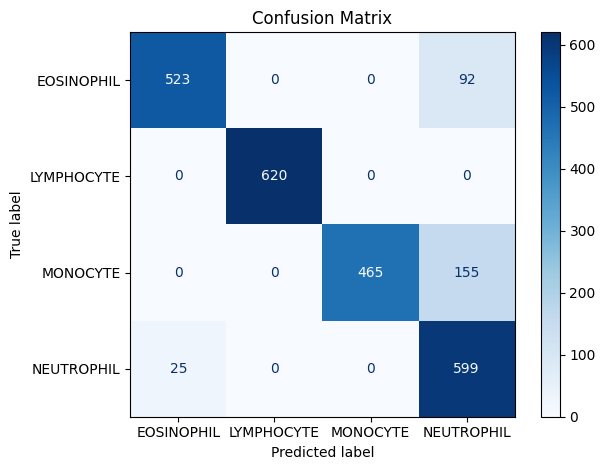

In [4]:
import os
import numpy as np
from PIL import Image
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# ==== CONFIG ====
PATCH_DIR = r'C:\Users\USER\Downloads\data\patches_with_original_test'  # Point to your TEST set
WEIGHTS_PATH = r'C:\Users\USER\Downloads\data\project - yolo\runs\model_weights-white_improved_os_org_v1.pth'
IMAGE_SIZE = (224, 224)
BATCH_SIZE = 16
NUM_CLASSES = 4
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ==== TRANSFORM ====
test_transform = transforms.Compose([
    transforms.Resize(IMAGE_SIZE),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# ==== DATASET & COLLATE ====
class PatchImageDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.samples = []
        self.class_to_idx = {cls: idx for idx, cls in enumerate(sorted(os.listdir(root_dir)))}
        self.idx_to_class = {v: k for k, v in self.class_to_idx.items()}

        for cls in self.class_to_idx:
            cls_path = os.path.join(root_dir, cls)
            for img_dir in os.listdir(cls_path):
                folder_path = os.path.join(cls_path, img_dir)
                if os.path.isdir(folder_path):
                    self.samples.append((folder_path, self.class_to_idx[cls]))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        folder, label = self.samples[idx]
        images = []

        # Load original image
        original_image_path = os.path.join(folder, "original.png")
        original_image = Image.open(original_image_path).convert("RGB")
        if self.transform:
            original_image = self.transform(original_image)

        for fname in os.listdir(folder):
            if fname.endswith('.png') and fname != "original.png":
                try:
                    img = Image.open(os.path.join(folder, fname)).convert('RGB')
                    if self.transform:
                        img = self.transform(img)
                    images.append(img)
                except:
                    continue

        if len(images) == 0:
            images.append(torch.zeros(3, *IMAGE_SIZE))

        return original_image, torch.stack(images), label

def custom_collate_fn(batch):
    originals, patches, labels = zip(*batch)
    return torch.stack(originals), [p for p in patches], torch.tensor(labels)

# ==== MODEL ====
class PatchClassifier(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.orig_features = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
        self.orig_features = nn.Sequential(*list(self.orig_features.children())[:-1])

        self.patch_features = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
        self.patch_features = nn.Sequential(*list(self.patch_features.children())[:-1])

        self.attention = nn.Sequential(
            nn.Linear(512, 512),
            nn.Tanh(),
            nn.LayerNorm(512),
            nn.Linear(512, 1),
            nn.Softmax(dim=1)
        )

        self.classifier = nn.Sequential(
            nn.Dropout(0.7),
            nn.Linear(1024, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(512, 256),
            nn.LayerNorm(256),
            nn.ReLU(),
            nn.Linear(256, num_classes)
        )

    def forward(self, originals, patch_lists):
        device = next(self.parameters()).device
        batch_features = []

        orig_feats = self.orig_features(originals.to(device)).squeeze()

        for i, patches in enumerate(patch_lists):
            patches = patches.to(device)
            feats = self.patch_features(patches).squeeze()
            if feats.ndim == 1:
                feats = feats.unsqueeze(0)

            weights = self.attention(feats)
            weighted_feat = (feats * weights).sum(dim=0)

            combined = torch.cat([orig_feats[i], weighted_feat], dim=0)
            batch_features.append(combined)

        return self.classifier(torch.stack(batch_features))

# ==== TEST FUNCTION ====
def test():
    dataset = PatchImageDataset(PATCH_DIR, transform=test_transform)
    dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=False, collate_fn=custom_collate_fn)
    model = PatchClassifier(NUM_CLASSES).to(DEVICE)
    model.load_state_dict(torch.load(WEIGHTS_PATH, map_location=DEVICE))
    model.eval()

    all_preds = []
    all_labels = []

    with torch.no_grad():
        for originals, patches, labels in tqdm(dataloader, desc="Testing"):
            outputs = model(originals, patches)
            _, preds = torch.max(outputs, 1)

            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.numpy())

    # Metrics
    class_names = list(dataset.class_to_idx.keys())
    print("\n=== Classification Report ===")
    print(classification_report(all_labels, all_preds, target_names=class_names))

    cm = confusion_matrix(all_labels, all_preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    disp.plot(cmap='Blues', values_format='d')
    plt.title("Confusion Matrix")
    plt.tight_layout()
    plt.show()

if __name__ == '__main__':
    test()


C:\Users\USER\AppData\Local\Temp\ipykernel_26768\3604534450.py:130: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(WEIGHTS_PATH, map_location


=== Classification Report ===
              precision    recall  f1-score   support

  EOSINOPHIL       0.89      0.87      0.88       615
  LYMPHOCYTE       1.00      0.98      0.99       620
    MONOCYTE       0.97      0.74      0.84       620
  NEUTROPHIL       0.70      0.90      0.79       624

    accuracy                           0.87      2479
   macro avg       0.89      0.87      0.87      2479
weighted avg       0.89      0.87      0.87      2479



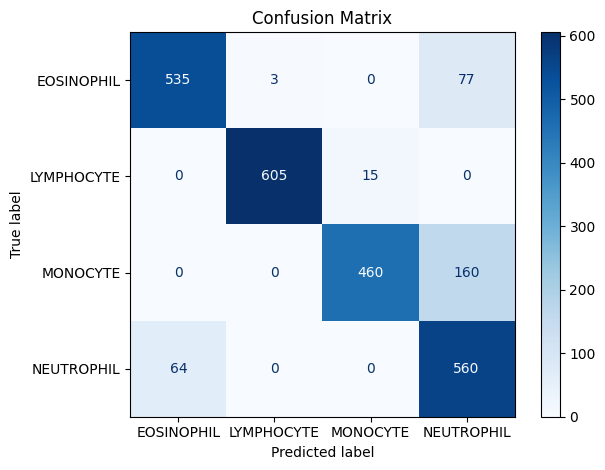

In [5]:
import os
import numpy as np
from PIL import Image
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# ==== CONFIG ====
PATCH_DIR = r'C:\Users\USER\Downloads\data\patches_with_original_test'  # Point to your TEST set
WEIGHTS_PATH = r'C:\Users\USER\Downloads\data\model_weights-white_improved_os_org_v1.pth'
IMAGE_SIZE = (224, 224)
BATCH_SIZE = 16
NUM_CLASSES = 4
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ==== TRANSFORM ====
test_transform = transforms.Compose([
    transforms.Resize(IMAGE_SIZE),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# ==== DATASET & COLLATE ====
class PatchImageDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.samples = []
        self.class_to_idx = {cls: idx for idx, cls in enumerate(sorted(os.listdir(root_dir)))}
        self.idx_to_class = {v: k for k, v in self.class_to_idx.items()}

        for cls in self.class_to_idx:
            cls_path = os.path.join(root_dir, cls)
            for img_dir in os.listdir(cls_path):
                folder_path = os.path.join(cls_path, img_dir)
                if os.path.isdir(folder_path):
                    self.samples.append((folder_path, self.class_to_idx[cls]))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        folder, label = self.samples[idx]
        images = []

        # Load original image
        original_image_path = os.path.join(folder, "original.png")
        original_image = Image.open(original_image_path).convert("RGB")
        if self.transform:
            original_image = self.transform(original_image)

        for fname in os.listdir(folder):
            if fname.endswith('.png') and fname != "original.png":
                try:
                    img = Image.open(os.path.join(folder, fname)).convert('RGB')
                    if self.transform:
                        img = self.transform(img)
                    images.append(img)
                except:
                    continue

        if len(images) == 0:
            images.append(torch.zeros(3, *IMAGE_SIZE))

        return original_image, torch.stack(images), label

def custom_collate_fn(batch):
    originals, patches, labels = zip(*batch)
    return torch.stack(originals), [p for p in patches], torch.tensor(labels)

# ==== MODEL ====
class PatchClassifier(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.orig_features = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
        self.orig_features = nn.Sequential(*list(self.orig_features.children())[:-1])

        self.patch_features = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
        self.patch_features = nn.Sequential(*list(self.patch_features.children())[:-1])

        self.attention = nn.Sequential(
            nn.Linear(512, 512),
            nn.Tanh(),
            nn.LayerNorm(512),
            nn.Linear(512, 1),
            nn.Softmax(dim=1)
        )

        self.classifier = nn.Sequential(
            nn.Dropout(0.7),
            nn.Linear(1024, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(512, 256),
            nn.LayerNorm(256),
            nn.ReLU(),
            nn.Linear(256, num_classes)
        )

    def forward(self, originals, patch_lists):
        device = next(self.parameters()).device
        batch_features = []

        orig_feats = self.orig_features(originals.to(device)).squeeze()

        for i, patches in enumerate(patch_lists):
            patches = patches.to(device)
            feats = self.patch_features(patches).squeeze()
            if feats.ndim == 1:
                feats = feats.unsqueeze(0)

            weights = self.attention(feats)
            weighted_feat = (feats * weights).sum(dim=0)

            combined = torch.cat([orig_feats[i], weighted_feat], dim=0)
            batch_features.append(combined)

        return self.classifier(torch.stack(batch_features))

# ==== TEST FUNCTION ====
def test():
    dataset = PatchImageDataset(PATCH_DIR, transform=test_transform)
    dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=False, collate_fn=custom_collate_fn)
    model = PatchClassifier(NUM_CLASSES).to(DEVICE)
    model.load_state_dict(torch.load(WEIGHTS_PATH, map_location=DEVICE))
    model.eval()

    all_preds = []
    all_labels = []

    with torch.no_grad():
        for originals, patches, labels in tqdm(dataloader, desc="Testing"):
            outputs = model(originals, patches)
            _, preds = torch.max(outputs, 1)

            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.numpy())

    # Metrics
    class_names = list(dataset.class_to_idx.keys())
    print("\n=== Classification Report ===")
    print(classification_report(all_labels, all_preds, target_names=class_names))

    cm = confusion_matrix(all_labels, all_preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    disp.plot(cmap='Blues', values_format='d')
    plt.title("Confusion Matrix")
    plt.tight_layout()
    plt.show()

if __name__ == '__main__':
    test()


C:\Users\USER\AppData\Local\Temp\ipykernel_26768\4109289615.py:130: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(WEIGHTS_PATH, map_location


=== Classification Report ===
              precision    recall  f1-score   support

  EOSINOPHIL       0.95      0.85      0.90       615
  LYMPHOCYTE       1.00      1.00      1.00       620
    MONOCYTE       1.00      0.75      0.86       620
  NEUTROPHIL       0.71      0.96      0.81       624

    accuracy                           0.89      2479
   macro avg       0.91      0.89      0.89      2479
weighted avg       0.91      0.89      0.89      2479



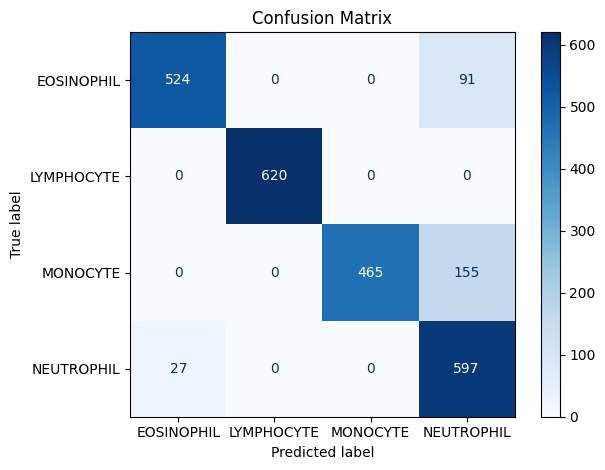

In [6]:
import os
import numpy as np
from PIL import Image
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# ==== CONFIG ====
PATCH_DIR = r'C:\Users\USER\Downloads\data\patches_with_original_test'  # Point to your TEST set
WEIGHTS_PATH = r'C:\Users\USER\Downloads\data\project - yolo\output\model_weights-white_improved_os_org_v1.pth'
IMAGE_SIZE = (224, 224)
BATCH_SIZE = 16
NUM_CLASSES = 4
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ==== TRANSFORM ====
test_transform = transforms.Compose([
    transforms.Resize(IMAGE_SIZE),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# ==== DATASET & COLLATE ====
class PatchImageDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.samples = []
        self.class_to_idx = {cls: idx for idx, cls in enumerate(sorted(os.listdir(root_dir)))}
        self.idx_to_class = {v: k for k, v in self.class_to_idx.items()}

        for cls in self.class_to_idx:
            cls_path = os.path.join(root_dir, cls)
            for img_dir in os.listdir(cls_path):
                folder_path = os.path.join(cls_path, img_dir)
                if os.path.isdir(folder_path):
                    self.samples.append((folder_path, self.class_to_idx[cls]))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        folder, label = self.samples[idx]
        images = []

        # Load original image
        original_image_path = os.path.join(folder, "original.png")
        original_image = Image.open(original_image_path).convert("RGB")
        if self.transform:
            original_image = self.transform(original_image)

        for fname in os.listdir(folder):
            if fname.endswith('.png') and fname != "original.png":
                try:
                    img = Image.open(os.path.join(folder, fname)).convert('RGB')
                    if self.transform:
                        img = self.transform(img)
                    images.append(img)
                except:
                    continue

        if len(images) == 0:
            images.append(torch.zeros(3, *IMAGE_SIZE))

        return original_image, torch.stack(images), label

def custom_collate_fn(batch):
    originals, patches, labels = zip(*batch)
    return torch.stack(originals), [p for p in patches], torch.tensor(labels)

# ==== MODEL ====
class PatchClassifier(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.orig_features = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
        self.orig_features = nn.Sequential(*list(self.orig_features.children())[:-1])

        self.patch_features = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
        self.patch_features = nn.Sequential(*list(self.patch_features.children())[:-1])

        self.attention = nn.Sequential(
            nn.Linear(512, 512),
            nn.Tanh(),
            nn.LayerNorm(512),
            nn.Linear(512, 1),
            nn.Softmax(dim=1)
        )

        self.classifier = nn.Sequential(
            nn.Dropout(0.7),
            nn.Linear(1024, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(512, 256),
            nn.LayerNorm(256),
            nn.ReLU(),
            nn.Linear(256, num_classes)
        )

    def forward(self, originals, patch_lists):
        device = next(self.parameters()).device
        batch_features = []

        orig_feats = self.orig_features(originals.to(device)).squeeze()

        for i, patches in enumerate(patch_lists):
            patches = patches.to(device)
            feats = self.patch_features(patches).squeeze()
            if feats.ndim == 1:
                feats = feats.unsqueeze(0)

            weights = self.attention(feats)
            weighted_feat = (feats * weights).sum(dim=0)

            combined = torch.cat([orig_feats[i], weighted_feat], dim=0)
            batch_features.append(combined)

        return self.classifier(torch.stack(batch_features))

# ==== TEST FUNCTION ====
def test():
    dataset = PatchImageDataset(PATCH_DIR, transform=test_transform)
    dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=False, collate_fn=custom_collate_fn)
    model = PatchClassifier(NUM_CLASSES).to(DEVICE)
    model.load_state_dict(torch.load(WEIGHTS_PATH, map_location=DEVICE))
    model.eval()

    all_preds = []
    all_labels = []

    with torch.no_grad():
        for originals, patches, labels in tqdm(dataloader, desc="Testing"):
            outputs = model(originals, patches)
            _, preds = torch.max(outputs, 1)

            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.numpy())

    # Metrics
    class_names = list(dataset.class_to_idx.keys())
    print("\n=== Classification Report ===")
    print(classification_report(all_labels, all_preds, target_names=class_names))

    cm = confusion_matrix(all_labels, all_preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    disp.plot(cmap='Blues', values_format='d')
    plt.title("Confusion Matrix")
    plt.tight_layout()
    plt.show()

if __name__ == '__main__':
    test()


C:\Users\USER\AppData\Local\Temp\ipykernel_26768\3028800568.py:130: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(WEIGHTS_PATH, map_location


=== Classification Report ===
              precision    recall  f1-score   support

  EOSINOPHIL       0.95      0.85      0.90       615
  LYMPHOCYTE       1.00      1.00      1.00       620
    MONOCYTE       1.00      0.75      0.86       620
  NEUTROPHIL       0.71      0.96      0.81       624

    accuracy                           0.89      2479
   macro avg       0.92      0.89      0.89      2479
weighted avg       0.92      0.89      0.89      2479



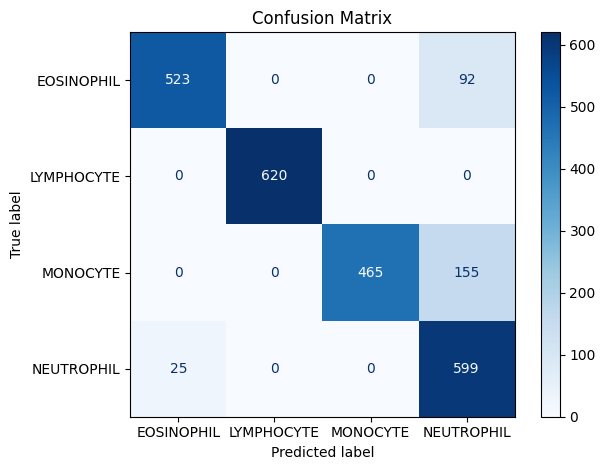

In [7]:
import os
import numpy as np
from PIL import Image
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# ==== CONFIG ====
PATCH_DIR = r'C:\Users\USER\Downloads\data\patches_with_original_test'  # Point to your TEST set
WEIGHTS_PATH = r'C:\Users\USER\Downloads\data\project - yolo\runs\model_weights-white_improved_os_org_v1.pth'
IMAGE_SIZE = (224, 224)
BATCH_SIZE = 16
NUM_CLASSES = 4
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ==== TRANSFORM ====
test_transform = transforms.Compose([
    transforms.Resize(IMAGE_SIZE),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# ==== DATASET & COLLATE ====
class PatchImageDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.samples = []
        self.class_to_idx = {cls: idx for idx, cls in enumerate(sorted(os.listdir(root_dir)))}
        self.idx_to_class = {v: k for k, v in self.class_to_idx.items()}

        for cls in self.class_to_idx:
            cls_path = os.path.join(root_dir, cls)
            for img_dir in os.listdir(cls_path):
                folder_path = os.path.join(cls_path, img_dir)
                if os.path.isdir(folder_path):
                    self.samples.append((folder_path, self.class_to_idx[cls]))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        folder, label = self.samples[idx]
        images = []

        # Load original image
        original_image_path = os.path.join(folder, "original.png")
        original_image = Image.open(original_image_path).convert("RGB")
        if self.transform:
            original_image = self.transform(original_image)

        for fname in os.listdir(folder):
            if fname.endswith('.png') and fname != "original.png":
                try:
                    img = Image.open(os.path.join(folder, fname)).convert('RGB')
                    if self.transform:
                        img = self.transform(img)
                    images.append(img)
                except:
                    continue

        if len(images) == 0:
            images.append(torch.zeros(3, *IMAGE_SIZE))

        return original_image, torch.stack(images), label

def custom_collate_fn(batch):
    originals, patches, labels = zip(*batch)
    return torch.stack(originals), [p for p in patches], torch.tensor(labels)

# ==== MODEL ====
class PatchClassifier(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.orig_features = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
        self.orig_features = nn.Sequential(*list(self.orig_features.children())[:-1])

        self.patch_features = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
        self.patch_features = nn.Sequential(*list(self.patch_features.children())[:-1])

        self.attention = nn.Sequential(
            nn.Linear(512, 512),
            nn.Tanh(),
            nn.LayerNorm(512),
            nn.Linear(512, 1),
            nn.Softmax(dim=1)
        )

        self.classifier = nn.Sequential(
            nn.Dropout(0.7),
            nn.Linear(1024, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(512, 256),
            nn.LayerNorm(256),
            nn.ReLU(),
            nn.Linear(256, num_classes)
        )

    def forward(self, originals, patch_lists):
        device = next(self.parameters()).device
        batch_features = []

        orig_feats = self.orig_features(originals.to(device)).squeeze()

        for i, patches in enumerate(patch_lists):
            patches = patches.to(device)
            feats = self.patch_features(patches).squeeze()
            if feats.ndim == 1:
                feats = feats.unsqueeze(0)

            weights = self.attention(feats)
            weighted_feat = (feats * weights).sum(dim=0)

            combined = torch.cat([orig_feats[i], weighted_feat], dim=0)
            batch_features.append(combined)

        return self.classifier(torch.stack(batch_features))

# ==== TEST FUNCTION ====
def test():
    dataset = PatchImageDataset(PATCH_DIR, transform=test_transform)
    dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=False, collate_fn=custom_collate_fn)
    model = PatchClassifier(NUM_CLASSES).to(DEVICE)
    model.load_state_dict(torch.load(WEIGHTS_PATH, map_location=DEVICE))
    model.eval()

    all_preds = []
    all_labels = []

    with torch.no_grad():
        for originals, patches, labels in tqdm(dataloader, desc="Testing"):
            outputs = model(originals, patches)
            _, preds = torch.max(outputs, 1)

            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.numpy())

    # Metrics
    class_names = list(dataset.class_to_idx.keys())
    print("\n=== Classification Report ===")
    print(classification_report(all_labels, all_preds, target_names=class_names))

    cm = confusion_matrix(all_labels, all_preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    disp.plot(cmap='Blues', values_format='d')
    plt.title("Confusion Matrix")
    plt.tight_layout()
    plt.show()

if __name__ == '__main__':
    test()


In [1]:
import pandas as pd
import joblib
from sklearn.preprocessing import LabelEncoder

# Load full cleaned dataset
df = pd.read_csv('cleaned__file.csv')

# Filter diseases with 100 or more samples
disease_counts = df['diseases'].value_counts()
valid_diseases = disease_counts[disease_counts >= 100].index
df_valid = df[df['diseases'].isin(valid_diseases)]

# Fit and save LabelEncoder
le = LabelEncoder()
le.fit(df_valid['diseases'])

# Save the encoder
joblib.dump(le, 'le_100plus.pkl')
print("LabelEncoder for 100+ samples saved as 'le_100plus.pkl'")


LabelEncoder for 100+ samples saved as 'le_100plus.pkl'


In [2]:
import pandas as pd
import joblib
from sklearn.preprocessing import LabelEncoder

# Load original cleaned dataset
df = pd.read_csv('cleaned__file.csv')

# Get disease frequency
disease_counts = df['diseases'].value_counts()

# Filter for diseases with 10–99 samples
valid_diseases = disease_counts[(disease_counts <= 100) & (disease_counts >= 10)].index
df_valid = df[df['diseases'].isin(valid_diseases)]

# Save filtered data (optional)
df_valid.to_csv('remaining_diseases_10to99.csv', index=False)

# Fit LabelEncoder on valid diseases
le = LabelEncoder()
le.fit(df_valid['diseases'])

# Save the encoder
joblib.dump(le, 'le_10to99.pkl')
print("LabelEncoder for 10–99 samples saved as 'le_10to99.pkl'")


LabelEncoder for 10–99 samples saved as 'le_10to99.pkl'


In [ ]:
import csv

def extract_column_names(csv_path):
    with open(csv_path, mode='r', newline='', encoding='utf-8') as file:
        reader = csv.reader(file)
        headers = next(reader)  # Read the first line
    return headers

# Example usage
csv_file_path = 'remaining_diseases_10to99.csv'  # Replace with your actual file path
column_names = extract_column_names(csv_file_path)
print("Column names:", column_names)
